In [2]:
%matplotlib inline

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mannwhitneyu
import seaborn as sns
from matplotlib.gridspec import GridSpec
import scanpy as sc
import muon as mu
import graphtools
import magic
from matplotlib.pyplot import rc_context
from matplotlib import gridspec
import os


from datashader.mpl_ext import dsshow
import datashader as ds

import matplotlib.colors
cmap = plt.cm.hsv
cmaplist = [cmap(i) for i in range(cmap.N)]
cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
cmaplist.reverse()
cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)

import matplotlib.patches as mpatches
import matplotlib.pyplot as plt

import sys
sys.path.append('../../../Code/')
from utils import read_dataset_log


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
from matplotlib import rcParams, font_manager
import matplotlib


# rcParams['pdf.fonttype'] = 42
# rcParams['ps.fonttype'] = 42
# rcParams['font.family'] = 'sans-serif'
# rcParams['font.sans-serif'] = ['Arial']

In [4]:
params = read_dataset_log('Dataset Paths')
params.index = params['dataset']
params

,dataset,usage_fn,gene_scores_fn,gene_tpm_fn,tcat_fn,tcat_fn_withsingletons,manual_gating_fn,manual_activation_gating_fn,activation_score_fn,metadata_fn,...,cnmf_dir,k,dt,processed_forcnmf_fn,tpm_counts_for_cnmf_fn,raw_counts_filt_fn,raw_counts_fn,dataset_type,tissue_type,context_label
dataset,,,,,,,,,,,,,,,,,,,,,
AMP-RA,AMP-RA,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMPRA....,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/AMPRA/Activa...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,...,/data/srlab1/TCAT/Data/PerDataset/AMPRA,34.0,0_15,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,/data/srlab1/TCAT/Data/PerDataset/AMPRA/AMP_AD...,discovery,Synovium,RA+OA
Pan-Cancer,Pan-Cancer,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Pa...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/Ac...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,...,/data/srlab1/TCAT/Data/PerDataset/Pancancer,38.0,0.15,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,NaN,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,/data/srlab1/TCAT/Data/PerDataset/Pancancer/pa...,discovery,Pan-Tissue,Cancer+Healthy
TBRU,TBRU,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/PerDataset/TBRU/TBRU.20...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/TBRU/Activat...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,...,/data/srlab1/TCAT/Data/PerDataset/TBRU,36.0,0_20,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,/data/srlab1/TCAT/Data/PerDataset/TBRU/tbru_ex...,discovery,Blood,Healthy
HIV-Vaccine,HIV-Vaccine,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/HIVV...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Manu...,NaN,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/Acti...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl,31.0,0_15,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,/data/srlab1/TCAT/Data/PerDataset/HaoEtAl/haoe...,discovery,Blood,Post-Vaccine+Healthy
UK-Covid,UK-Covid,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/UKCO...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,NaN,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/Acti...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID,44.0,0_20,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,NaN,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,/data/srlab1/TCAT/Data/PerDataset/UKCOVID/hani...,discovery,Blood,Covid-19+Healthy
COMBAT,COMBAT,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/COMBA...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/TCAT/TCAT_Usage.2023101...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Manua...,/data/srlab1/TCAT/Data/PerDataset/COMBAT/Activ...,/data/

In [14]:
manual_gating_fn = '../../../Data/PerDataset/Stimseq/ManualGating.Magic.FinalLabel.20230831.tsv'

In [15]:
lineage_gating = pd.read_csv(manual_gating_fn#params.loc[dataset, 'manual_gating_fn']
                             , index_col = 0, sep = '\t')
lineage_gating.columns = ['gating']

lineage_gating['class'] = np.nan
lineage_gating.loc[lineage_gating['gating'].str.contains('CD4'), 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating']=='Treg', 'class'] = 'CD4'
lineage_gating.loc[lineage_gating['gating'].str.contains('CD8'), 'class'] = 'CD8'
lineage_gating.loc[lineage_gating['class'].isna(), 'class'] = 'Other'

# Prepare markers

In [5]:
outdir = '../../../Data/PerDataset/Stimseq'

In [ ]:
figdir = '../../../Figures/Components'

In [6]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ForMAGIC.h5ad')
print(outfn)

../../../Data/PerDataset/Stimseq/ADT_TP10KCLR_ForMAGIC.h5ad


In [7]:
adata_ADT = sc.read(outfn)

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [8]:
adata_ADT.var.index = ['AB_' + x.replace('_prot', '') for x in adata_ADT.var.index]

In [9]:
sorted(adata_ADT.var.index)

['AB_ArmenianHamsterIgGIsotypeCtrl',
 'AB_CD101_or_BB27',
 'AB_CD103_or_IntegrinaE',
 'AB_CD105',
 'AB_CD107a_or_LAMP-1',
 'AB_CD112_or_Nectin-2',
 'AB_CD119_or_IFN-gRachain',
 'AB_CD11a',
 'AB_CD11b',
 'AB_CD11c',
 'AB_CD122_or_IL-2Rb',
 'AB_CD123',
 'AB_CD124_or_IL-4Ra',
 'AB_CD127_or_IL-7Ra',
 'AB_CD13',
 'AB_CD134_or_OX40',
 'AB_CD137_or_4-1BB',
 'AB_CD14',
 'AB_CD141_or_Thrombomodulin',
 'AB_CD146',
 'AB_CD152_or_CTLA-4',
 'AB_CD154',
 'AB_CD155_or_PVR',
 'AB_CD158_or_KIR2DL1_or_S1_or_S3_or_S5',
 'AB_CD158b_or_KIR2DL2_or_L3_NKAT2',
 'AB_CD158e1_or_KIR3DL1_NKB1',
 'AB_CD16',
 'AB_CD161',
 'AB_CD163',
 'AB_CD169_or_Sialoadhesin_Siglec-1',
 'AB_CD18',
 'AB_CD183_or_CXCR3',
 'AB_CD185_or_CXCR5',
 'AB_CD19',
 'AB_CD194_or_CCR4',
 'AB_CD195_or_CCR5',
 'AB_CD196_or_CCR6',
 'AB_CD1c',
 'AB_CD1d',
 'AB_CD2',
 'AB_CD20',
 'AB_CD21',
 'AB_CD22',
 'AB_CD223_or_LAG-3',
 'AB_CD224',
 'AB_CD226_or_DNAM-1',
 'AB_CD23',
 'AB_CD24',
 'AB_CD244_or_2B4',
 'AB_CD25',
 'AB_CD26',
 'AB_CD267_or_TACI',
 

In [10]:
adt_markers = ['AB_CD25', 'AB_CD134_or_OX40',
               #'AB_CD38', 'AB_CD279', 
               'AB_CD54', 
               'AB_CD69', 'AB_CD71', 
               'AB_CD274_or_B7-H1_PD-L1', 'AB_CD95_or_Fas']
    
#     'AB_CD3-1', 'AB_CD4-2',
#                'AB_CD8', 'AB_CD45RA', 'AB_CD45RO',  'AB_CD18', 'AB_CD161',  'AB_CD194', 'AB_CD195', 'AB_CD196', 'AB_CXCR3',
#                'AB_CD25', 'AB_CD127', 
#                'AB_CD27-1',
#                'AB_TCR-Vd2', 'AB_TCR-V-7.2', 'AB_TCR-V-9', 'AB_abTCR', 'AB_gdTCR',
#                'AB_CD31', 'AB_CD62L', 'AB_CCR7',
#                'AB_CD314',
#                'AB_CD38-1', 'AB_CD39',
#               'AB_CD94', 'AB_CD49b', 'AB_CD28'
              # ] 
    

In [13]:
sorted(adata_ADT.var.index)

['AB_ArmenianHamsterIgGIsotypeCtrl',
 'AB_CD101_or_BB27',
 'AB_CD103_or_IntegrinaE',
 'AB_CD105',
 'AB_CD107a_or_LAMP-1',
 'AB_CD112_or_Nectin-2',
 'AB_CD119_or_IFN-gRachain',
 'AB_CD11a',
 'AB_CD11b',
 'AB_CD11c',
 'AB_CD122_or_IL-2Rb',
 'AB_CD123',
 'AB_CD124_or_IL-4Ra',
 'AB_CD127_or_IL-7Ra',
 'AB_CD13',
 'AB_CD134_or_OX40',
 'AB_CD137_or_4-1BB',
 'AB_CD14',
 'AB_CD141_or_Thrombomodulin',
 'AB_CD146',
 'AB_CD152_or_CTLA-4',
 'AB_CD154',
 'AB_CD155_or_PVR',
 'AB_CD158_or_KIR2DL1_or_S1_or_S3_or_S5',
 'AB_CD158b_or_KIR2DL2_or_L3_NKAT2',
 'AB_CD158e1_or_KIR3DL1_NKB1',
 'AB_CD16',
 'AB_CD161',
 'AB_CD163',
 'AB_CD169_or_Sialoadhesin_Siglec-1',
 'AB_CD18',
 'AB_CD183_or_CXCR3',
 'AB_CD185_or_CXCR5',
 'AB_CD19',
 'AB_CD194_or_CCR4',
 'AB_CD195_or_CCR5',
 'AB_CD196_or_CCR6',
 'AB_CD1c',
 'AB_CD1d',
 'AB_CD2',
 'AB_CD20',
 'AB_CD21',
 'AB_CD22',
 'AB_CD223_or_LAG-3',
 'AB_CD224',
 'AB_CD226_or_DNAM-1',
 'AB_CD23',
 'AB_CD24',
 'AB_CD244_or_2B4',
 'AB_CD25',
 'AB_CD26',
 'AB_CD267_or_TACI',
 

In [11]:
set(adt_markers) - set(adata_ADT.var.index)

set()

In [12]:
adt_markers = list(set(adt_markers).intersection(adata_ADT.var.index))

In [56]:
G = graphtools.Graph(data=adata_ADT.obsp['connectivities'], precomputed='affinity')
magic_operator = magic.MAGIC(t=3)
magic_operator.fit(adata_ADT.X, graph=G)
markers_magic_adt = magic_operator.transform(X=adata_ADT[:, adt_markers].X)
markers_magic_adt = pd.DataFrame(markers_magic_adt, index=adata_ADT.obs.index, columns=adt_markers)

Running MAGIC on 43222 cells and 137 genes.
Using precomputed graph and diffusion operator...
Calculating imputation...
Calculated imputation in 0.01 seconds.


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/graphtools/base.py:554: RuntimeWarning: K should have a non-zero diagonal
  warnings.warn("K should have a non-zero diagonal", RuntimeWarning)
/PHShome/mc1070/.local/lib/python3.7/site-packages/magic/magic.py:546: UserWarning: Running MAGIC.transform on different data to that which was used for MAGIC.fit may not produce sensible output, unless it comes from the same manifold.
  UserWarning,


In [57]:
markers_magic_adt

,AB_CD134_or_OX40,AB_CD69,AB_CD25,AB_CD71,AB_CD54,AB_CD274_or_B7-H1_PD-L1,AB_CD95_or_Fas
3_AAACCTGAGACCGGAT,3.805203,1.086683,1.632293,1.973392,2.240308,3.348847,3.681901
3_AAACCTGAGAGGGCTT,3.359566,0.764695,1.119558,1.988654,1.519075,2.964107,1.907298
3_AAACCTGAGAGTCTGG,5.012706,3.612461,2.752125,3.545763,3.780656,4.876997,3.482264
3_AAACCTGAGCTAGCCC,3.665844,1.288062,2.022933,2.364575,2.252969,3.454038,2.906424
3_AAACCTGAGCTGCCCA,4.278913,1.906135,2.246756,2.527745,2.452979,3.821059,3.831448
...,...,...,...,...,...,...,...
2_TTTGTCATCAGGCCCA,4.044666,1.524630,1.591555,1.968206,2.064970,3.353351,3.682537
2_TTTGTCATCATATCGG,3.102369,1.493847,0.741060,1.279662,1.755159,2.327445,2.758611
2_TTTGTCATCATTATCC,3.166531,0.779637,0.784675,1.577788,1.265266,2.534634,1.728921
2_TTTGTCATCGGCTACG,3.544675,0.855866,1.187783,1.759475,1.489474,2.951273,1.847616


In [58]:
markers_magic = markers_magic_adt

In [59]:
outfn = os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/Stimseq/MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [60]:
markers_magic.to_csv(outfn, sep='\t')

In [61]:
unsmoothed_markers = pd.DataFrame(np.array(adata_ADT[:, adt_markers].X), 
                                  index=adata_ADT.obs.index,
                         columns=adt_markers)



In [62]:
outfn = os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv')
print(outfn)

../../../Data/PerDataset/Stimseq/UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv


In [63]:
unsmoothed_markers.to_csv(outfn, sep='\t')

# Gate on markers

In [64]:
markers_magic = pd.read_csv(os.path.join(outdir, 'MagicMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [65]:
unsmoothed_markers = pd.read_csv(os.path.join(outdir, 'UnsmoothedMarker.ActivationOnly.ADT_CLRTP10K.tsv'), 
                            index_col = 0, sep = '\t'
                           )

In [26]:
from scipy.stats import pearsonr
from scipy.stats import spearmanr

## All cells

In [28]:
dataset = 'Stimseq'

AB_CD134_or_OX40 AB_CD134_or_OX40
AB_CD134_or_OX40 AB_CD279
AB_CD134_or_OX40 AB_CD69
AB_CD134_or_OX40 AB_CD25
AB_CD134_or_OX40 AB_CD38
AB_CD134_or_OX40 AB_CD71
AB_CD134_or_OX40 AB_CD54
AB_CD134_or_OX40 AB_CD274_or_B7-H1_PD-L1
AB_CD134_or_OX40 AB_CD95_or_Fas
AB_CD279 AB_CD134_or_OX40
AB_CD279 AB_CD279
AB_CD279 AB_CD69
AB_CD279 AB_CD25
AB_CD279 AB_CD38
AB_CD279 AB_CD71
AB_CD279 AB_CD54
AB_CD279 AB_CD274_or_B7-H1_PD-L1
AB_CD279 AB_CD95_or_Fas
AB_CD69 AB_CD134_or_OX40
AB_CD69 AB_CD279
AB_CD69 AB_CD69
AB_CD69 AB_CD25
AB_CD69 AB_CD38
AB_CD69 AB_CD71
AB_CD69 AB_CD54
AB_CD69 AB_CD274_or_B7-H1_PD-L1
AB_CD69 AB_CD95_or_Fas
AB_CD25 AB_CD134_or_OX40
AB_CD25 AB_CD279
AB_CD25 AB_CD69
AB_CD25 AB_CD25
AB_CD25 AB_CD38
AB_CD25 AB_CD71
AB_CD25 AB_CD54
AB_CD25 AB_CD274_or_B7-H1_PD-L1


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":


AB_CD25 AB_CD95_or_Fas
AB_CD38 AB_CD134_or_OX40
AB_CD38 AB_CD279
AB_CD38 AB_CD69
AB_CD38 AB_CD25
AB_CD38 AB_CD38
AB_CD38 AB_CD71
AB_CD38 AB_CD54
AB_CD38 AB_CD274_or_B7-H1_PD-L1
AB_CD38 AB_CD95_or_Fas
AB_CD71 AB_CD134_or_OX40
AB_CD71 AB_CD279
AB_CD71 AB_CD69
AB_CD71 AB_CD25
AB_CD71 AB_CD38
AB_CD71 AB_CD71
AB_CD71 AB_CD54
AB_CD71 AB_CD274_or_B7-H1_PD-L1
AB_CD71 AB_CD95_or_Fas
AB_CD54 AB_CD134_or_OX40
AB_CD54 AB_CD279
AB_CD54 AB_CD69
AB_CD54 AB_CD25
AB_CD54 AB_CD38
AB_CD54 AB_CD71
AB_CD54 AB_CD54
AB_CD54 AB_CD274_or_B7-H1_PD-L1
AB_CD54 AB_CD95_or_Fas
AB_CD274_or_B7-H1_PD-L1 AB_CD134_or_OX40
AB_CD274_or_B7-H1_PD-L1 AB_CD279
AB_CD274_or_B7-H1_PD-L1 AB_CD69
AB_CD274_or_B7-H1_PD-L1 AB_CD25
AB_CD274_or_B7-H1_PD-L1 AB_CD38
AB_CD274_or_B7-H1_PD-L1 AB_CD71
AB_CD274_or_B7-H1_PD-L1 AB_CD54
AB_CD274_or_B7-H1_PD-L1 AB_CD274_or_B7-H1_PD-L1
AB_CD274_or_B7-H1_PD-L1 AB_CD95_or_Fas
AB_CD95_or_Fas AB_CD134_or_OX40
AB_CD95_or_Fas AB_CD279
AB_CD95_or_Fas AB_CD69
AB_CD95_or_Fas AB_CD25
AB_CD95_or_Fas AB_CD38


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


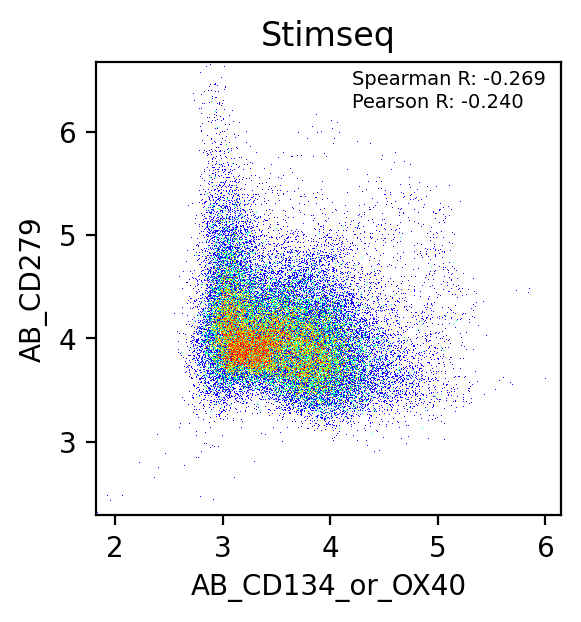

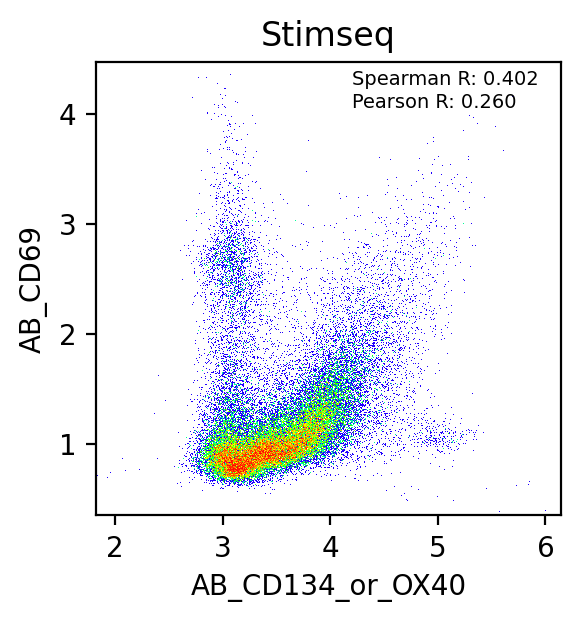

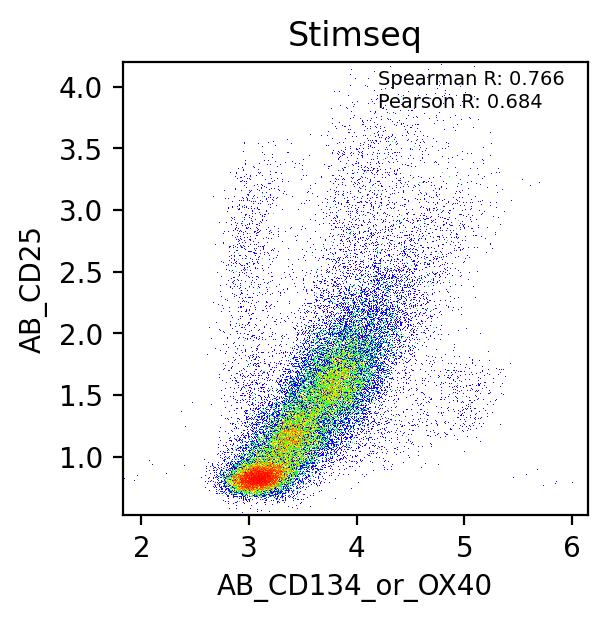

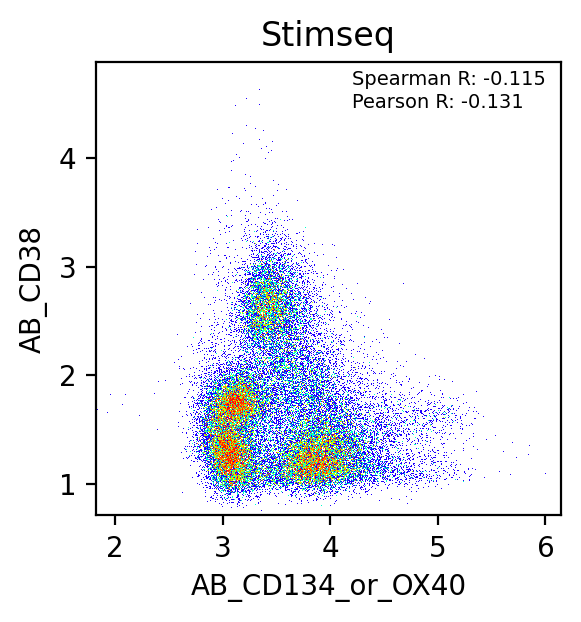

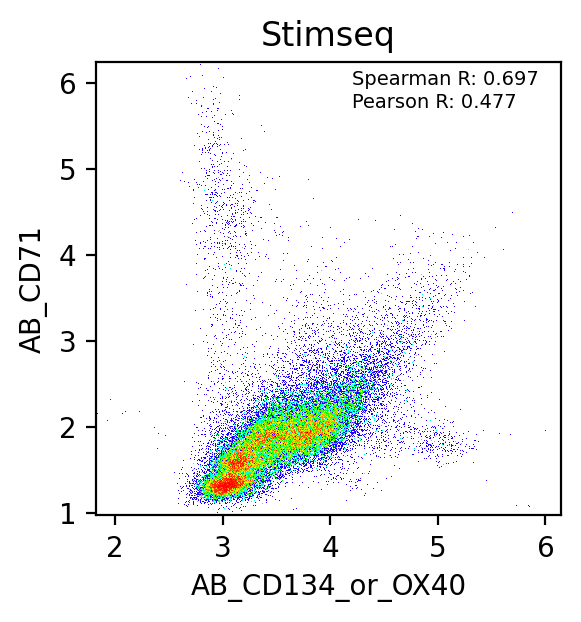

...

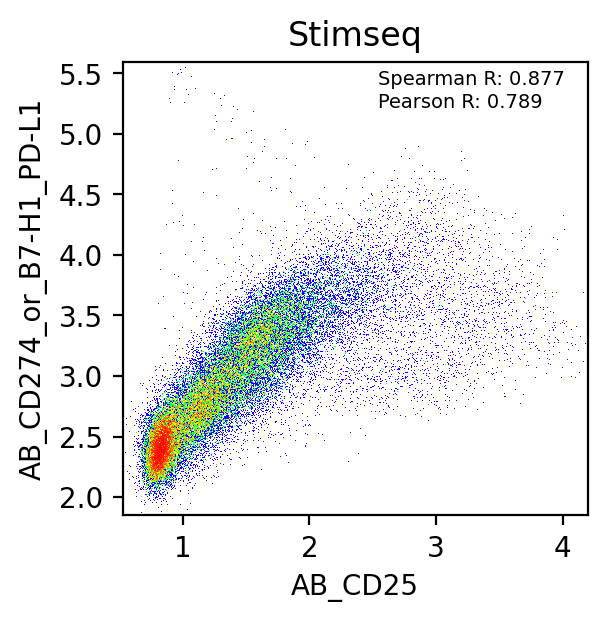

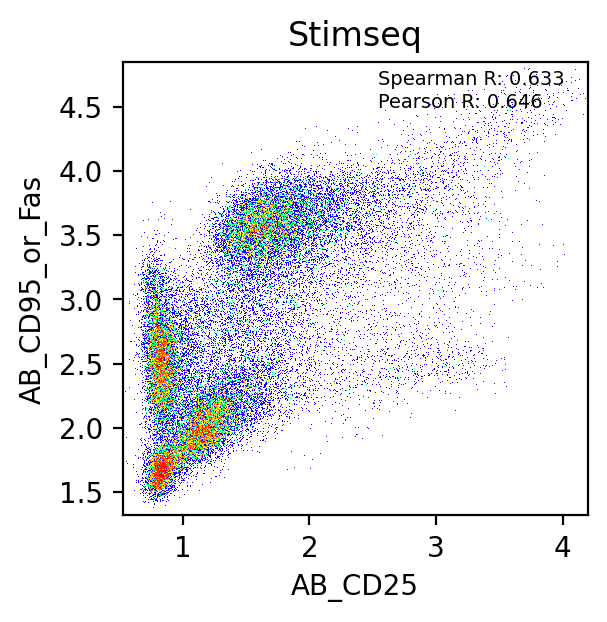

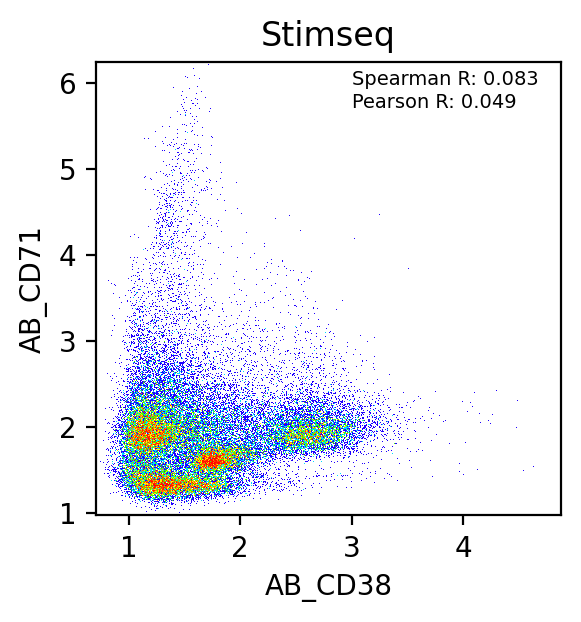

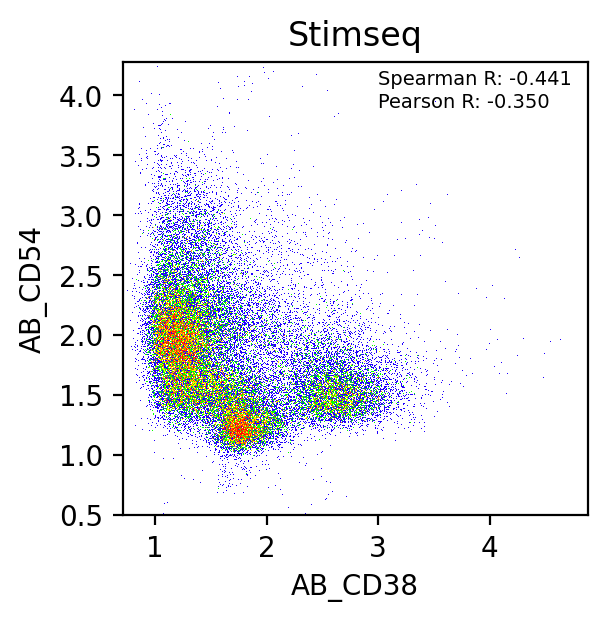

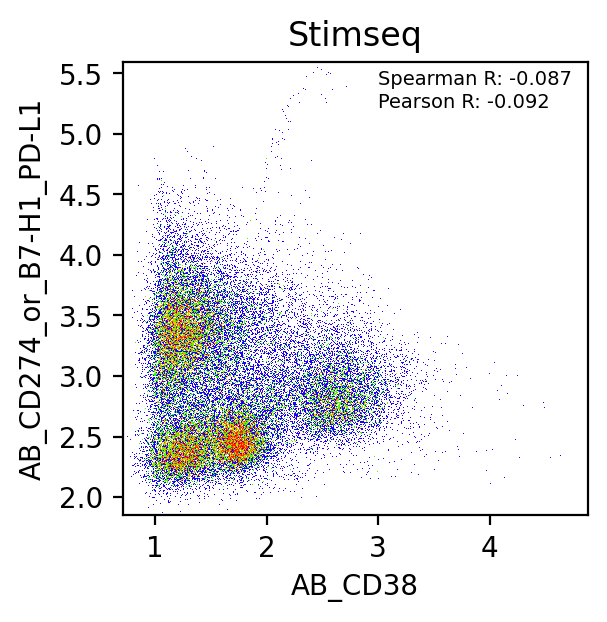

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


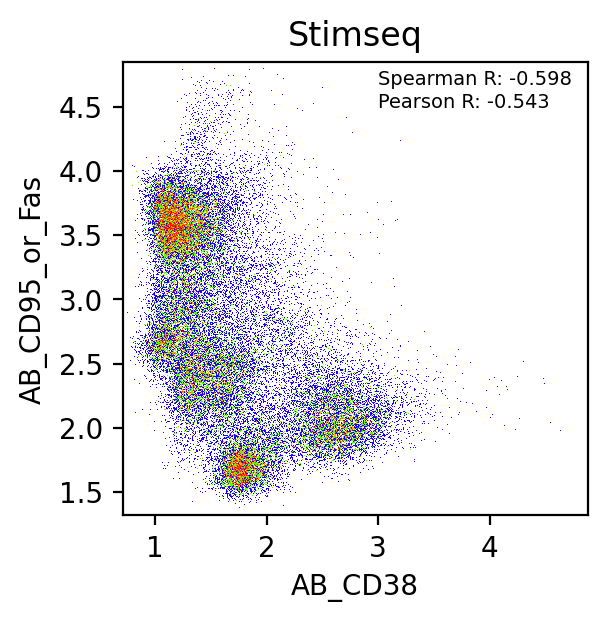

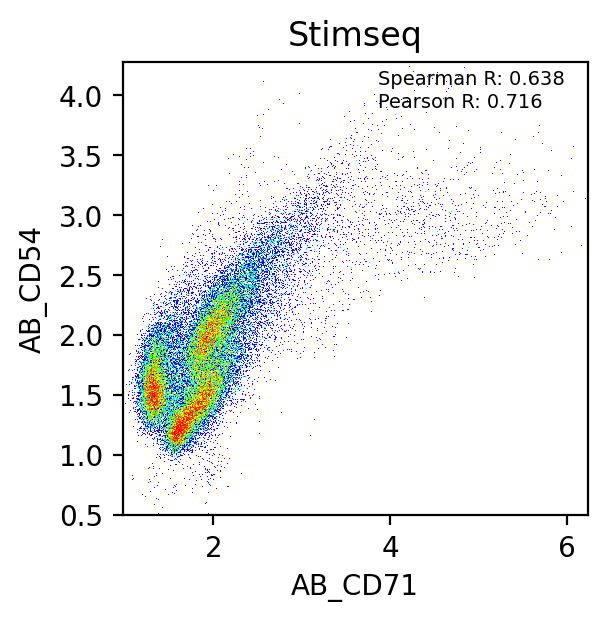

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


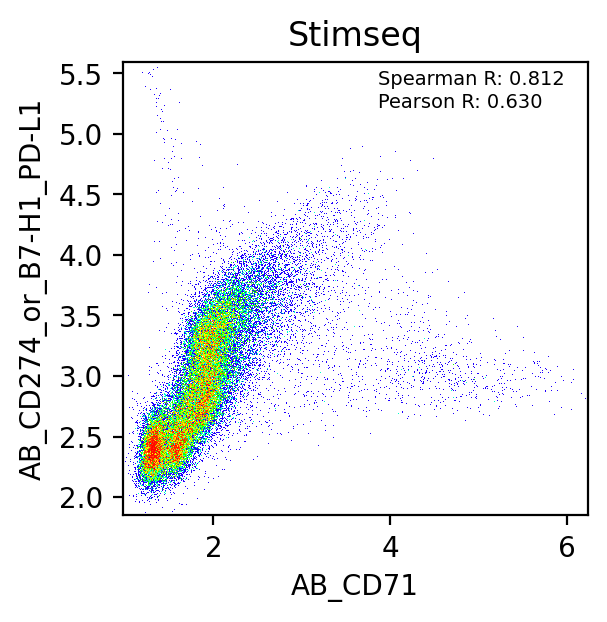

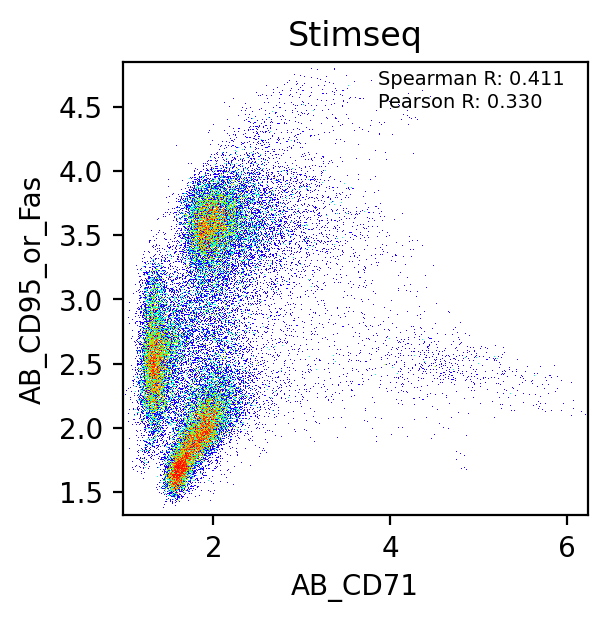

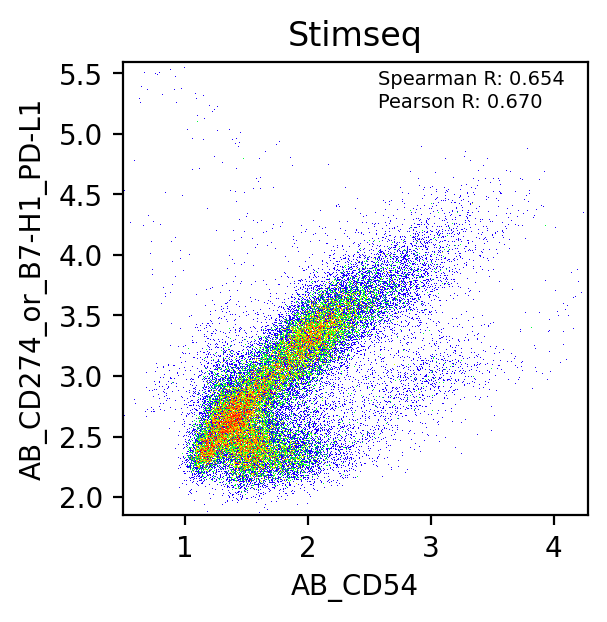

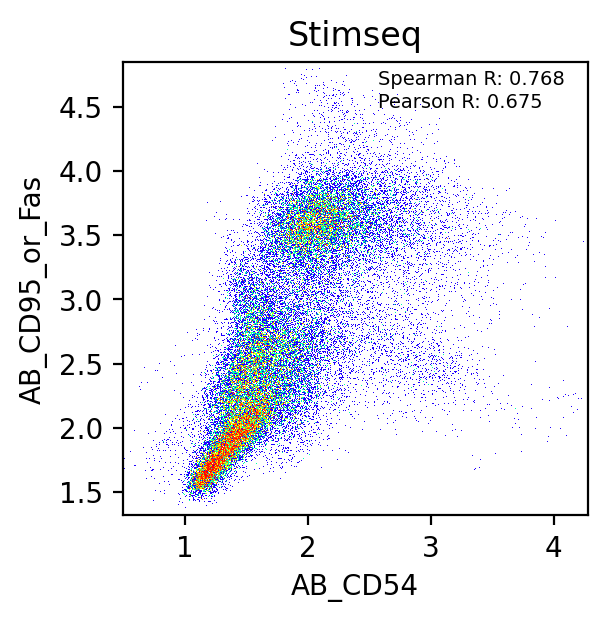

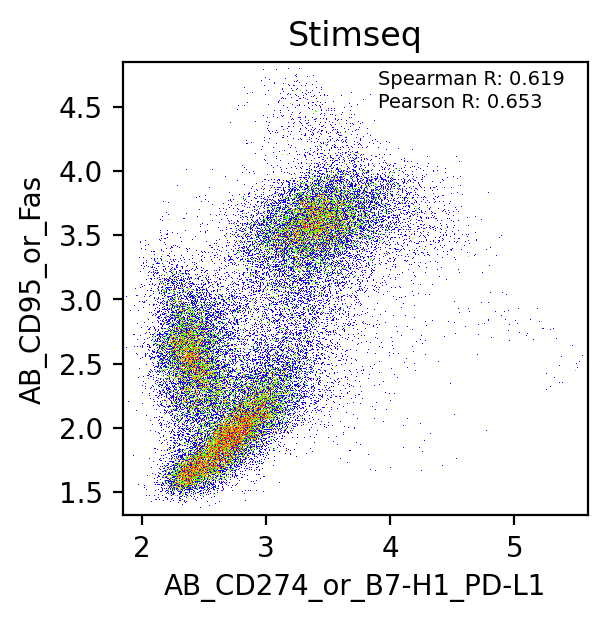

In [29]:
for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title(dataset)

0 AB_CD134_or_OX40
0 AB_CD134_or_OX40
1 AB_CD134_or_OX40
2 AB_CD134_or_OX40
3 AB_CD134_or_OX40
4 AB_CD134_or_OX40
5 AB_CD134_or_OX40
6 AB_CD134_or_OX40
7 AB_CD134_or_OX40
8 AB_CD134_or_OX40
1 AB_CD279
1 AB_CD279
2 AB_CD279
3 AB_CD279
4 AB_CD279
5 AB_CD279
6 AB_CD279
7 AB_CD279
8 AB_CD279
2 AB_CD69
2 AB_CD69
3 AB_CD69
4 AB_CD69
5 AB_CD69
6 AB_CD69
7 AB_CD69
8 AB_CD69
3 AB_CD25
3 AB_CD25
4 AB_CD25
5 AB_CD25
6 AB_CD25
7 AB_CD25
8 AB_CD25
4 AB_CD38
4 AB_CD38
5 AB_CD38
6 AB_CD38
7 AB_CD38
8 AB_CD38
5 AB_CD71
5 AB_CD71
6 AB_CD71
7 AB_CD71
8 AB_CD71
6 AB_CD54
6 AB_CD54
7 AB_CD54
8 AB_CD54
7 AB_CD274_or_B7-H1_PD-L1
7 AB_CD274_or_B7-H1_PD-L1
8 AB_CD274_or_B7-H1_PD-L1
8 AB_CD95_or_Fas
8 AB_CD95_or_Fas


Text(0.5, 0.9, 'Stimseq')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


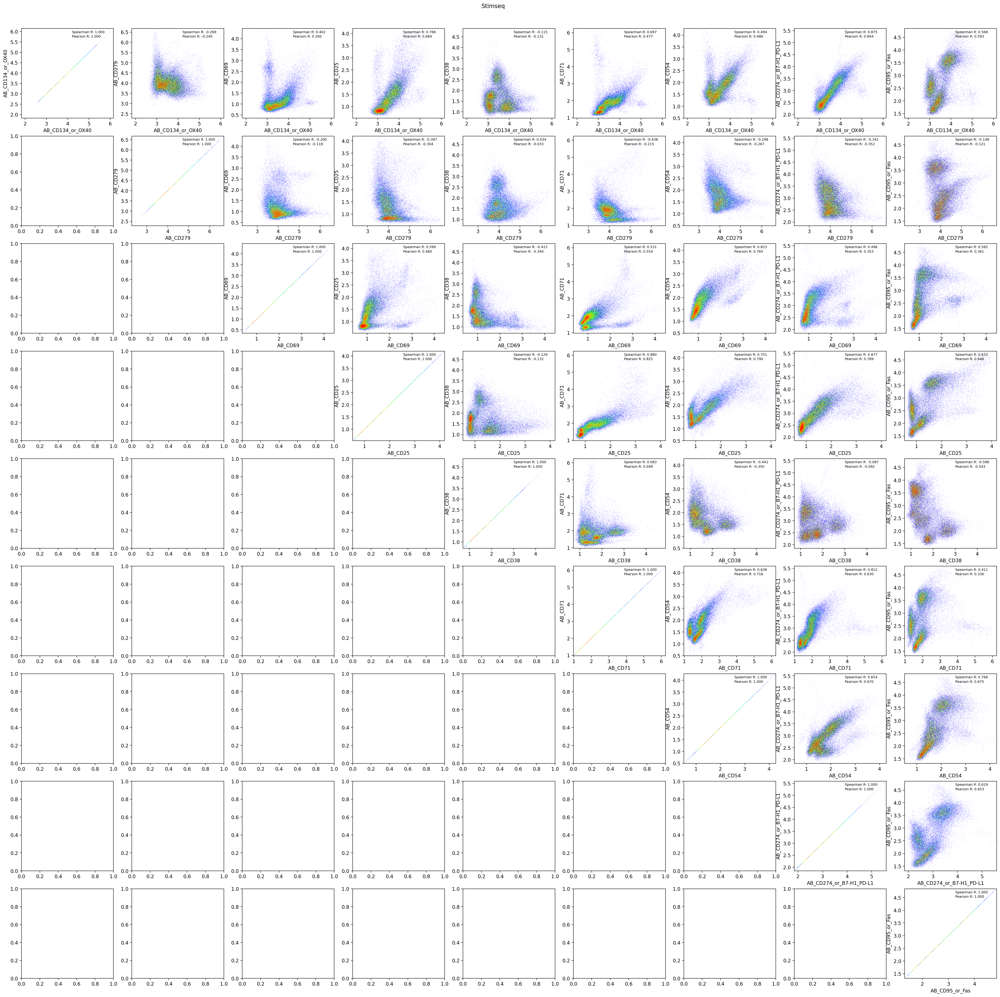

In [30]:
nrows = len(markers_magic.columns)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                               nrows = nrows, ncols = ncols)

for i, p1 in enumerate(markers_magic.columns):
    print(i, p1)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # j = j-1
        if j >= i:
            print(j, p1)
            ax = axes[i, j]
            x = markers_magic[p1]
            y = markers_magic[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
plt.suptitle(dataset,y = 0.9)

AB_CD134_or_OX40 AB_CD134_or_OX40
AB_CD134_or_OX40 AB_CD279
AB_CD134_or_OX40 AB_CD69
AB_CD134_or_OX40 AB_CD25
AB_CD134_or_OX40 AB_CD38
AB_CD134_or_OX40 AB_CD71
AB_CD134_or_OX40 AB_CD54
AB_CD134_or_OX40 AB_CD274_or_B7-H1_PD-L1
AB_CD134_or_OX40 AB_CD95_or_Fas
AB_CD279 AB_CD134_or_OX40
AB_CD279 AB_CD279
AB_CD279 AB_CD69
AB_CD279 AB_CD25
AB_CD279 AB_CD38
AB_CD279 AB_CD71
AB_CD279 AB_CD54
AB_CD279 AB_CD274_or_B7-H1_PD-L1
AB_CD279 AB_CD95_or_Fas
AB_CD69 AB_CD134_or_OX40
AB_CD69 AB_CD279
AB_CD69 AB_CD69
AB_CD69 AB_CD25
AB_CD69 AB_CD38
AB_CD69 AB_CD71
AB_CD69 AB_CD54
AB_CD69 AB_CD274_or_B7-H1_PD-L1
AB_CD69 AB_CD95_or_Fas
AB_CD25 AB_CD134_or_OX40
AB_CD25 AB_CD279
AB_CD25 AB_CD69
AB_CD25 AB_CD25
AB_CD25 AB_CD38
AB_CD25 AB_CD71
AB_CD25 AB_CD54
AB_CD25 AB_CD274_or_B7-H1_PD-L1


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == "":


AB_CD25 AB_CD95_or_Fas
AB_CD38 AB_CD134_or_OX40
AB_CD38 AB_CD279
AB_CD38 AB_CD69
AB_CD38 AB_CD25
AB_CD38 AB_CD38
AB_CD38 AB_CD71
AB_CD38 AB_CD54
AB_CD38 AB_CD274_or_B7-H1_PD-L1
AB_CD38 AB_CD95_or_Fas
AB_CD71 AB_CD134_or_OX40
AB_CD71 AB_CD279
AB_CD71 AB_CD69
AB_CD71 AB_CD25
AB_CD71 AB_CD38
AB_CD71 AB_CD71
AB_CD71 AB_CD54
AB_CD71 AB_CD274_or_B7-H1_PD-L1
AB_CD71 AB_CD95_or_Fas
AB_CD54 AB_CD134_or_OX40
AB_CD54 AB_CD279
AB_CD54 AB_CD69
AB_CD54 AB_CD25
AB_CD54 AB_CD38
AB_CD54 AB_CD71
AB_CD54 AB_CD54
AB_CD54 AB_CD274_or_B7-H1_PD-L1
AB_CD54 AB_CD95_or_Fas
AB_CD274_or_B7-H1_PD-L1 AB_CD134_or_OX40
AB_CD274_or_B7-H1_PD-L1 AB_CD279
AB_CD274_or_B7-H1_PD-L1 AB_CD69
AB_CD274_or_B7-H1_PD-L1 AB_CD25
AB_CD274_or_B7-H1_PD-L1 AB_CD38
AB_CD274_or_B7-H1_PD-L1 AB_CD71
AB_CD274_or_B7-H1_PD-L1 AB_CD54
AB_CD274_or_B7-H1_PD-L1 AB_CD274_or_B7-H1_PD-L1
AB_CD274_or_B7-H1_PD-L1 AB_CD95_or_Fas
AB_CD95_or_Fas AB_CD134_or_OX40
AB_CD95_or_Fas AB_CD279
AB_CD95_or_Fas AB_CD69
AB_CD95_or_Fas AB_CD25
AB_CD95_or_Fas AB_CD38


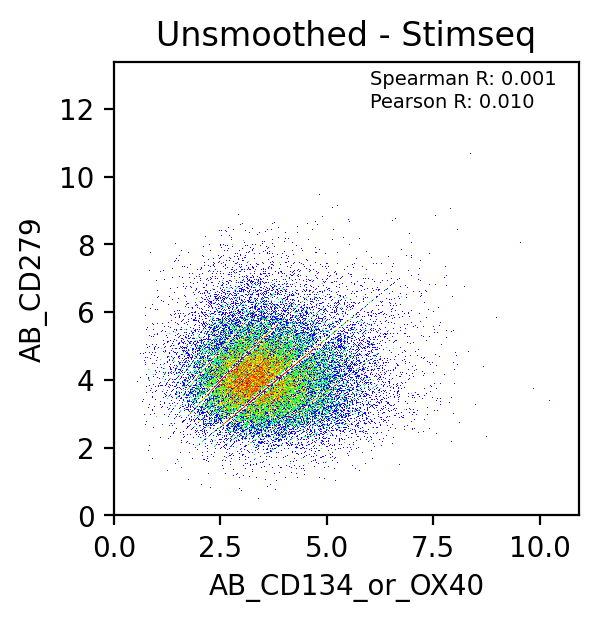

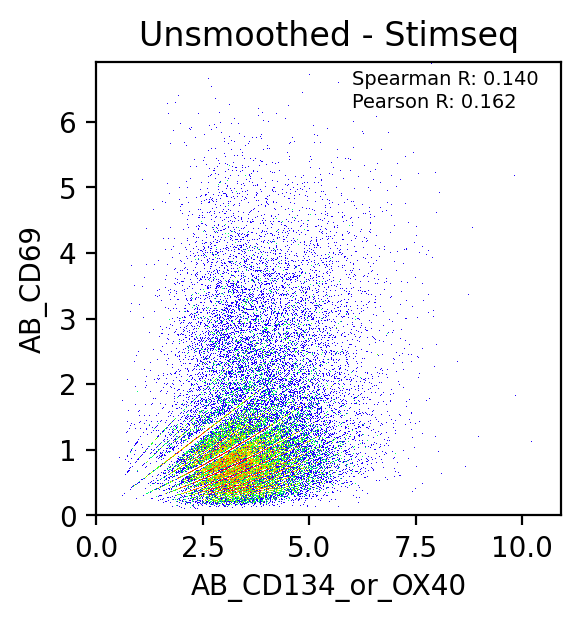

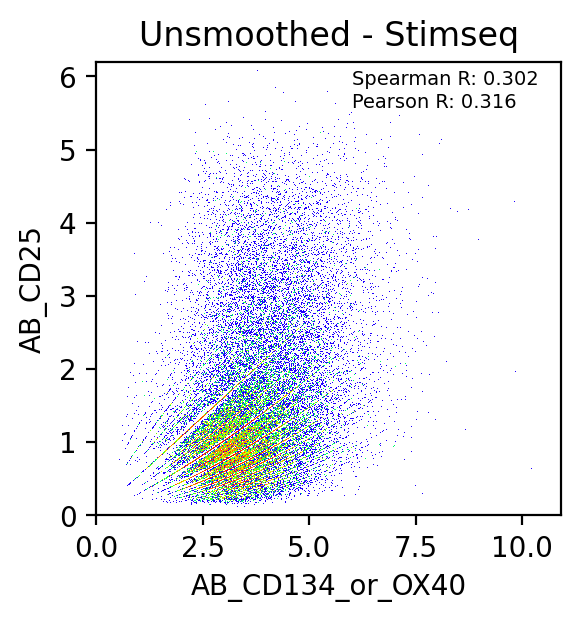

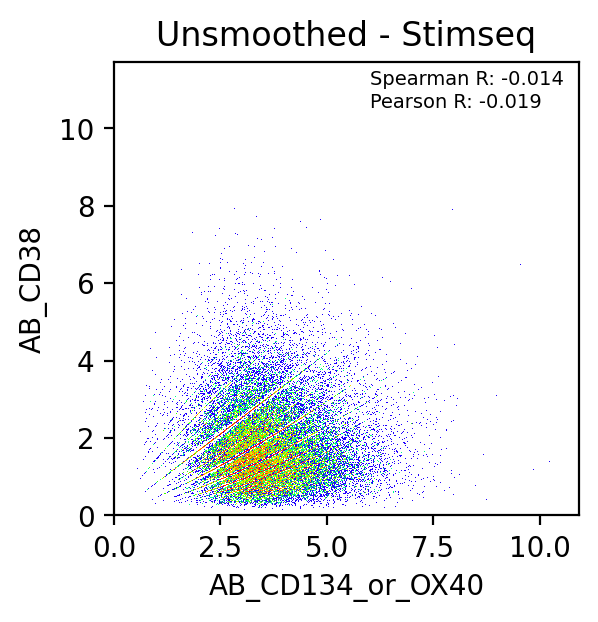

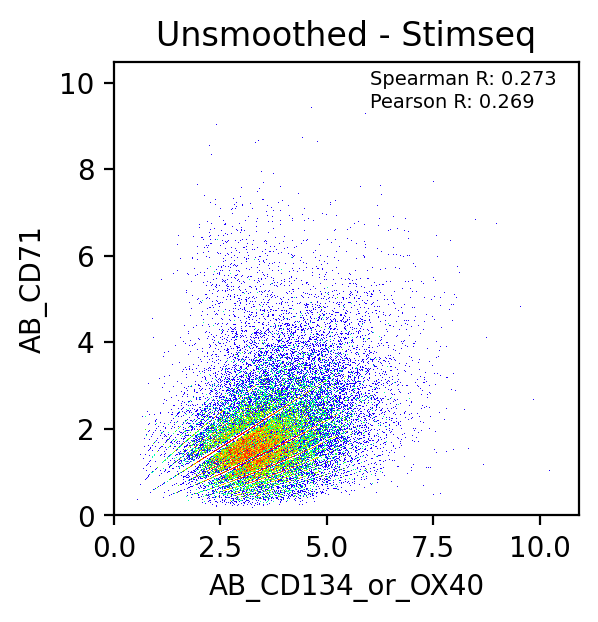

...

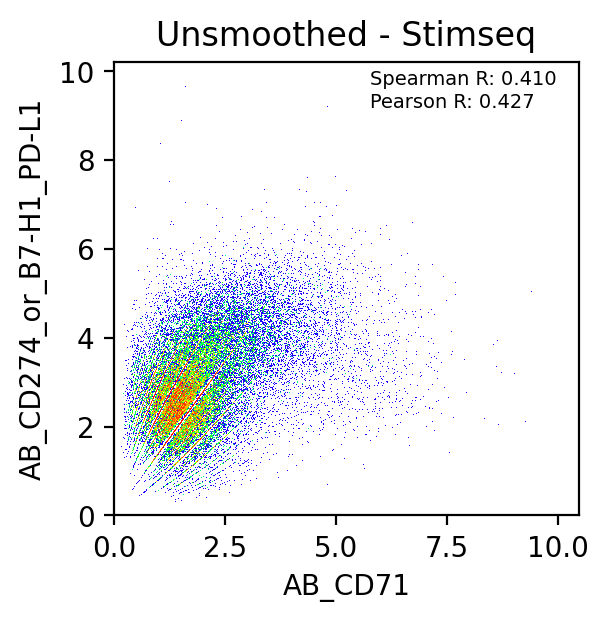

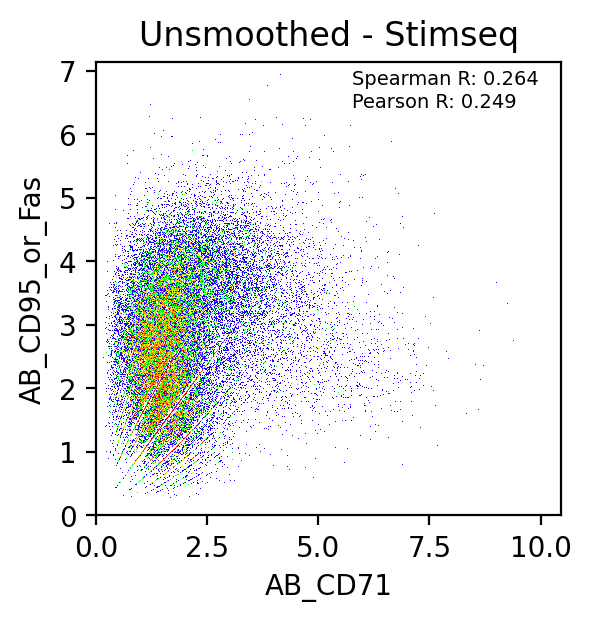

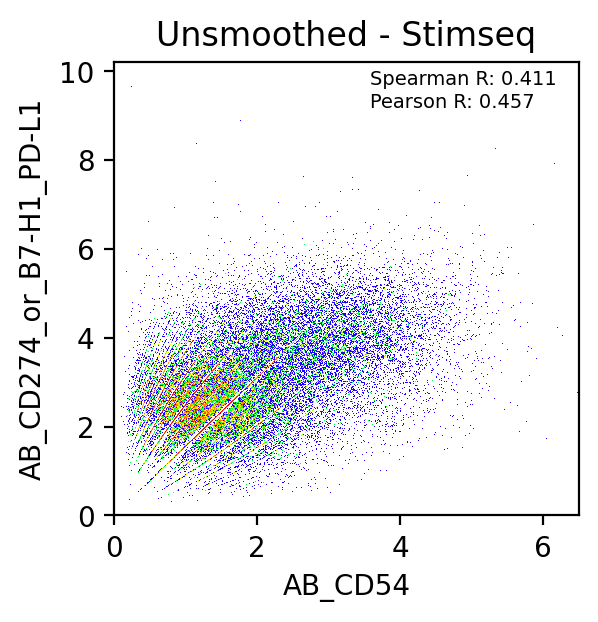

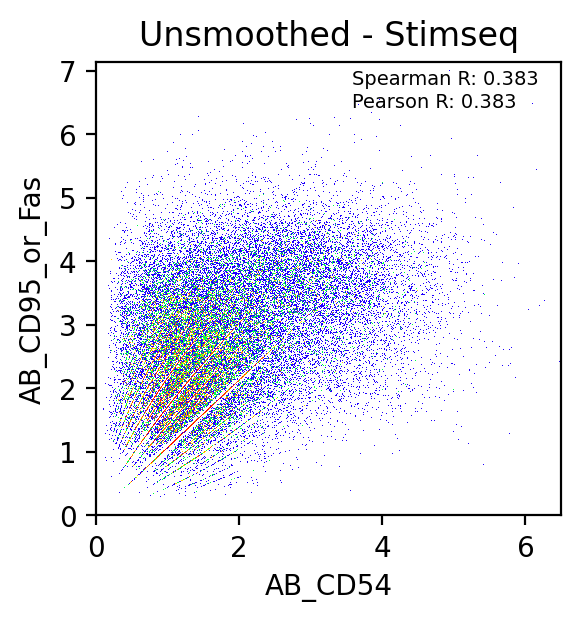

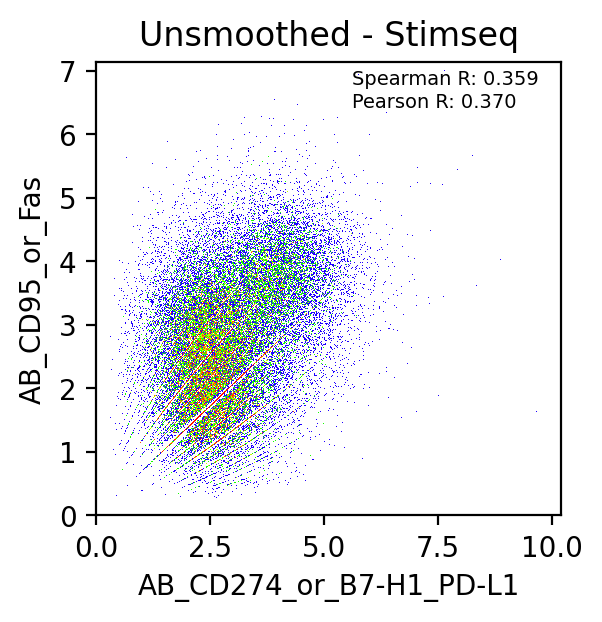

In [31]:
for i, p1 in enumerate(markers_magic.columns):
    
    for j, p2 in enumerate(markers_magic.columns):
        print(p1, p2)
        if j > i:
            x = unsmoothed_markers[p1]
            y = unsmoothed_markers[p2]
            
            r_p, _ = pearsonr(x, y)
            r_s, _ = spearmanr(x, y)

            fig, ax = plt.subplots(dpi = 200, figsize = (3, 3))
            # ax.scatter(x, y)
            dsshow(pd.DataFrame({'x':x, 'y':y}), 
                   ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
            # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
            ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
            ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
            ax.set_xlabel(p1)
            ax.set_ylabel(p2)
            ax.set_title('Unsmoothed - %s' % dataset)

In [73]:
# cmap = plt.cm.hsv
# cmaplist = [cmap(i) for i in range(cmap.N)]
# cmaplist = cmaplist[0:round(len(cmaplist)*0.7)]
# cmaplist.reverse()
# cmap = matplotlib.colors.LinearSegmentedColormap.from_list('', cmaplist, cmap.N)
    
def gate(data, g1, g2, ind=None, vertical_gate=None, horizontal_gate=None, quadrant_gate=None,
         labfontsize=9, plot_labeled=False, upper_only=False, ax=None):
    
    
    if ax is None:
        fig = plt.figure(constrained_layout=True, figsize=(2., 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.95, top=.92)
        ax = fig.add_subplot(gs[0])

    if ind  is None:
        ind = pd.Series(np.array([True]*data.shape[0]), data.index)
    
    
    x = data.loc[ind, g1]
    y = data.loc[ind, g2]
    
    dsshow(pd.DataFrame({'x':x, 'y':y}), ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
    ax.set_xlabel(g1, fontsize=labfontsize)
    ax.set_ylabel(g2, fontsize=labfontsize)

    
    if vertical_gate is not None:
        xlim = ax.get_xlim()
        ax.hlines(y=vertical_gate['vthresh'], xmin=xlim[0], xmax=xlim[1], linestyle='--', color='k', linewidth=1)
        ax.set_xlim(xlim)
        
            
        initial_res = (data.loc[ind, g2]>vertical_gate['vthresh']).replace({True:vertical_gate['above_name'], False:vertical_gate['below_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
    elif horizontal_gate is not None:
        ylim = ax.get_ylim()
        ax.vlines(x=horizontal_gate['hthresh'], ymin=ylim[0], ymax=ylim[1], linestyle='--', color='k', linewidth=1)
        ax.set_ylim(ylim)
        
        initial_res = (data.loc[ind, g1]>horizontal_gate['hthresh']).replace({False:horizontal_gate['left_name'], True:horizontal_gate['right_name']})
        final_res = ind.copy()
        final_res.loc[ind] = initial_res
        final_res.loc[~ind] = np.nan
        
        
    elif quadrant_gate is not None:
        xlim = ax.get_xlim()
        ylim = ax.get_ylim()
        if not upper_only:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=xlim[0]-1, xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=ylim[0]-1, ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)
        else:
            ax.hlines(y=quadrant_gate['vthresh'], xmin=quadrant_gate['hthresh'], xmax=xlim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_xlim(xlim)
            ax.vlines(x=quadrant_gate['hthresh'], ymin=quadrant_gate['vthresh'], ymax=ylim[1]+1, linestyle='--', color='k', linewidth=1)
            ax.set_ylim(ylim)            
            

        indh = data.loc[ind, g1]> quadrant_gate['hthresh']
        indv = data.loc[ind, g2]> quadrant_gate['vthresh']
        final_res = ind.replace(False,np.nan)
        for hval,vval, lab in [[False, False, quadrant_gate['ll']], [True, False, quadrant_gate['lr']], [False, True, quadrant_gate['ul']], [True, True, quadrant_gate['ur']]]:
            tolab = (indh==hval) & (indv==vval)
            final_res.loc[tolab.index[tolab]] = lab
            
            
    if plot_labeled:
        fig = plt.figure(constrained_layout=True, figsize=(2.4, 2.), dpi=200)
        gs = gridspec.GridSpec(1, 1, figure=fig, left=0.2,
                       bottom=.2, right=.8, top=.92)
        ax2 = fig.add_subplot(gs[0])
        dat = pd.concat([x,y,final_res], axis=1)
        dat.columns = [g1, g2, 'label']
        for (k,g) in dat.groupby('label'):
            ax2.scatter(g[g1], g[g2], label=k, s=.5, edgecolor='None')
        ax2.legend(bbox_to_anchor=(1,1), markerscale=3, fontsize=6)
        
        
        
    return(final_res, ax)

In [ ]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated'])


In [ ]:
gating

In [ ]:
gating['gdT'], ax = gate(markers_magic, g1, g2, ind=None, vertical_gate=vgate, plot_labeled=False)


In [ ]:
g1 = 'AB_CD279'
g2 = 'AB_CD38'   
gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
                      quadrant_gate={'vthresh':1.8, 'hthresh':2.5, 'ur':'MAIT', 'ul':'ab', 'll':'ab', 'lr':'ab'}, plot_labeled=False, upper_only=True)
ax.text(3.3,6.5, 'Activated', fontsize=9)
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

In [ ]:
g1 = 'AB_CD279'
g2 = 'AB_CD38'   
gating['Activated'], ax = gate(markers_magic, g1, g2, ind=None,
                      quadrant_gate={'vthresh':2.5, 'hthresh':5.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(6,5, 'Activated', fontsize=9)
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.png'))
# plt.savefig(os.path.join(figdir, 'ManualGating_COMBAT_gdT.pdf'))

In [ ]:
gating['Activated'].value_counts()

In [ ]:
outfn = os.path.join(outdir, 'ManualGatingActivation.Magic.20230111.tsv')
print(outfn)

In [ ]:
gating.to_csv(outfn, sep='\t')

## By lineage classes

In [37]:
lineage_gating.value_counts()

gating     class
CD4_CM     CD4      9486
CD4_Naive  CD4      8917
CD8_EM     CD8      5565
CD8_Naive  CD8      4868
CD4_EM     CD4      4428
Treg       CD4      2073
CD8_TEMRA  CD8      1752
DP         Other    1535
gdT        Other    1508
MAIT       Other    1428
CD8_CM     CD8      1219
DN         Other     292
CD4_TEMRA  CD4       151
dtype: int64

In [38]:
lineage_gating['class'].value_counts()

CD4      25055
CD8      13404
Other     4763
Name: class, dtype: int64

3_AAACCTGAGACCGGAT    +
3_AAACCTGAGAGGGCTT    U
3_AAACCTGAGAGTCTGG    +
3_AAACCTGAGCTAGCCC    U
3_AAACCTGAGCTGCCCA    +
                     ..
2_TTTGTCATCAGGCCCA    U
2_TTTGTCATCATATCGG    +
2_TTTGTCATCATTATCC    -
2_TTTGTCATCGGCTACG    U
2_TTTGTCATCTCCAGGG    -
Name: Sort_Status, Length: 43222, dtype: category
Categories (3, object): ['+', '-', 'U']

In [134]:
lineage_gating.loc[adata_ADT.obs.index, 'class'].value_counts()

CD4      25055
CD8      13404
Other     4763
Name: class, dtype: int64

In [135]:
lineage_gating.loc[adata_ADT.obs.index, 'class'].groupby(adata_ADT.obs['Sort_Status']).value_counts()

Sort_Status  class
+            CD4      9925
             CD8      2187
             Other    1123
-            CD4      7593
             CD8      6043
             Other    1892
U            CD4      7537
             CD8      5174
             Other    1748
Name: class, dtype: int64

CD4
Other
CD8


/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

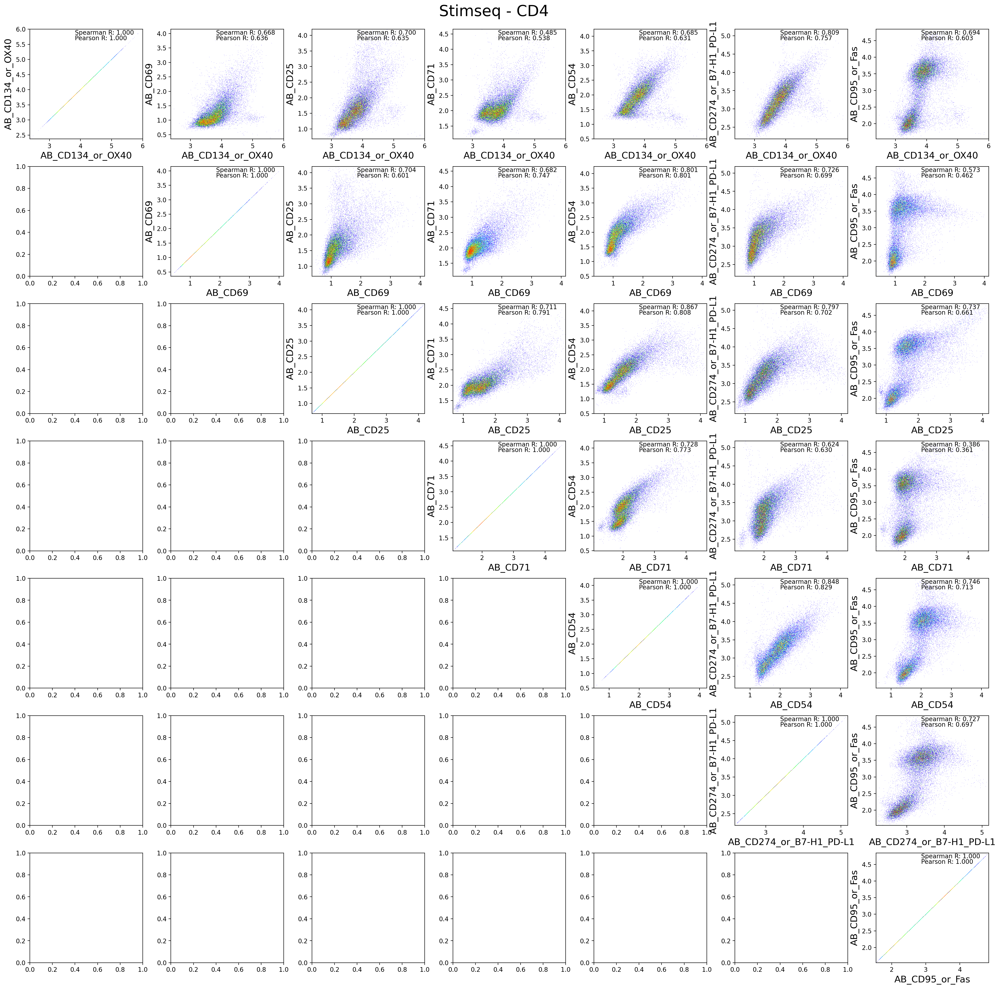

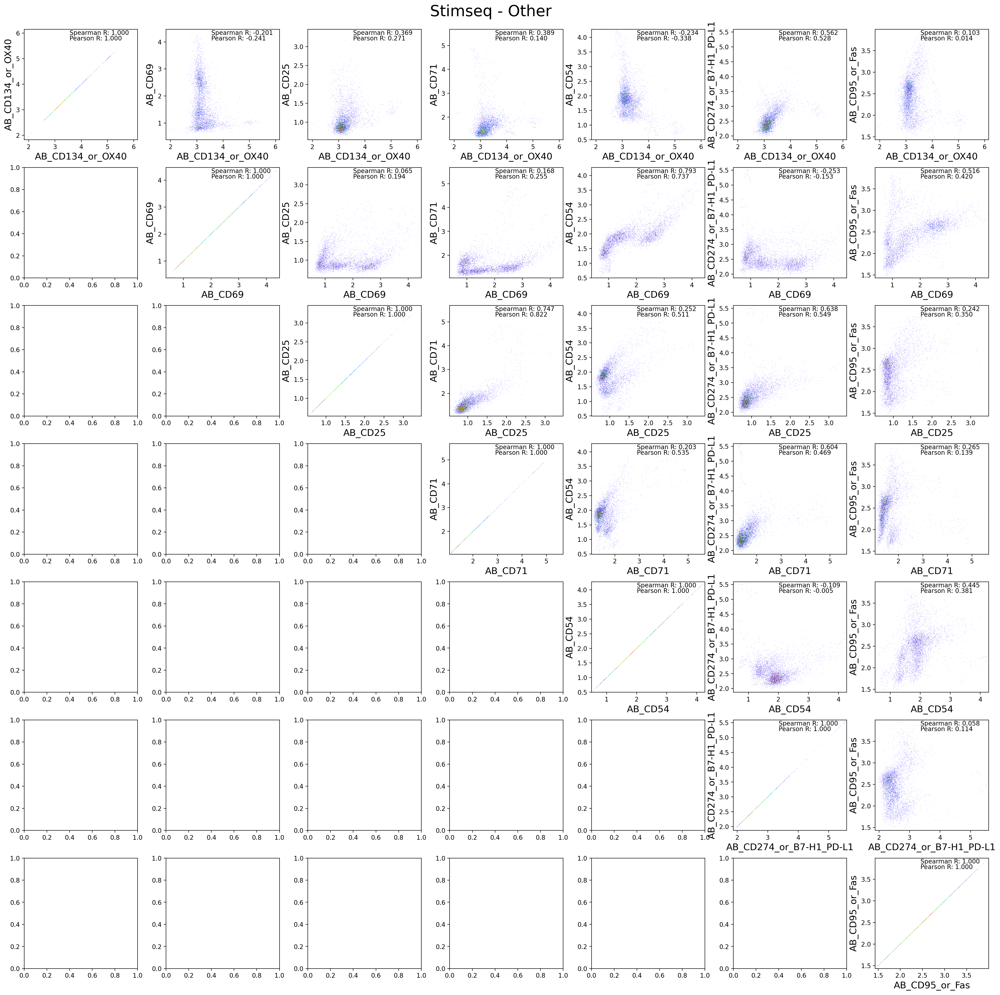

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."


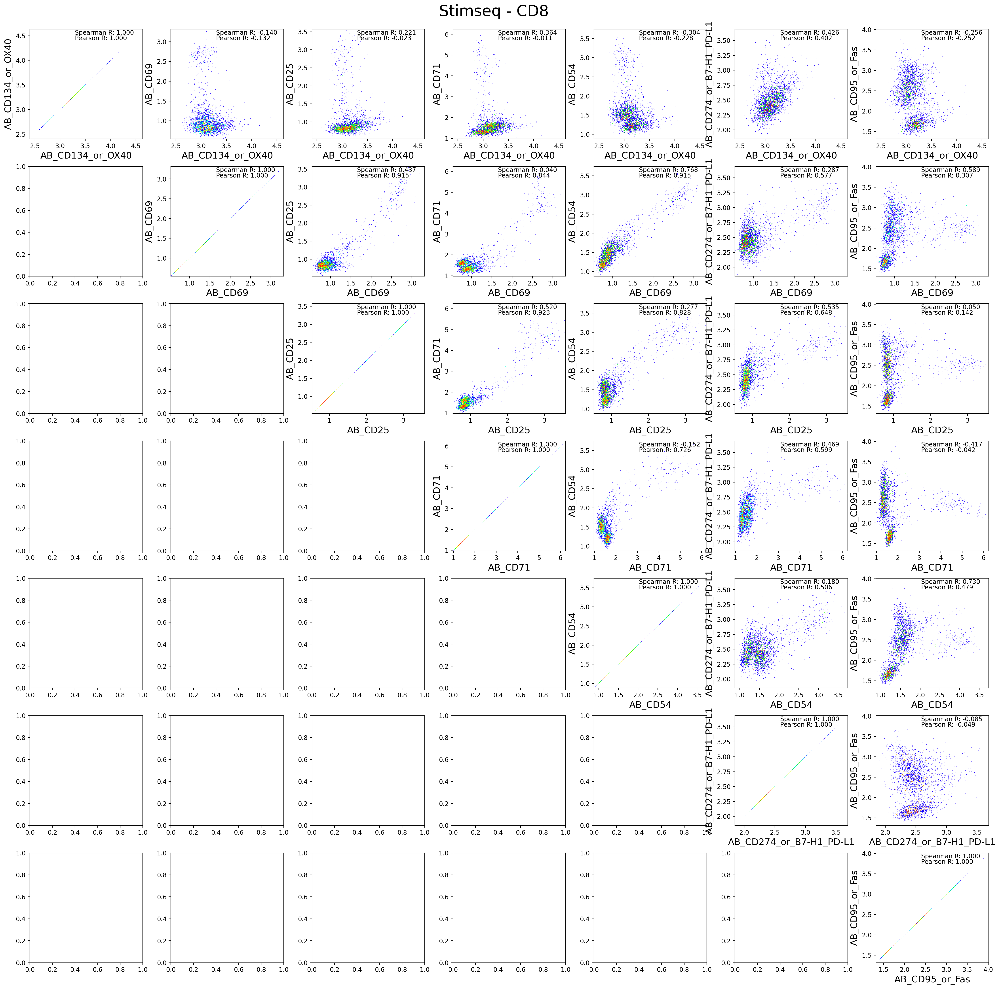

In [66]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    fontsize = 15
    nrows = len(markers_magic.columns)
    ncols = len(markers_magic.columns)
    fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(markers_magic.columns)),
                                                   nrows = nrows, ncols = ncols, 
                            gridspec_kw = {'wspace' : 0.25, 'hspace' : 0.25})
    
    ind = lineage_gating[lineage_gating['class']==lineage].index
    for i, p1 in enumerate(markers_magic.columns):
        # print(i, p1)
        # i = i-1

        for j, p2 in enumerate(markers_magic.columns):
            # j = j-1
            if j >= i:
                # print(j, p1)
                ax = axes[i, j]
                x = markers_magic.loc[ind, p1]
                y = markers_magic.loc[ind, p2]

                r_p, _ = pearsonr(x, y)
                r_s, _ = spearmanr(x, y)

                # ax.scatter(x, y)
                dsshow(pd.DataFrame({'x':x, 'y':y}), 
                       ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
                # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
                ax.text(x = .4, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 10, transform=ax.transAxes)
                ax.text(x = .4, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 10, transform=ax.transAxes)
                ax.set_xlabel(p1, fontsize = fontsize)
                ax.set_ylabel(p2, fontsize = fontsize)
    plt.suptitle('%s - %s' % (dataset, lineage), y = 0.9, fontsize = fontsize + 10)

In [69]:
gating = pd.DataFrame(index=markers_magic.index, columns=['Activated_CD8', 'Activated_CD4', 
                                                          'Activated_Other', 'Class'])
gating['Class'] = lineage_gating.loc[gating.index, 'class']

In [70]:
lineage = 'CD8'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [71]:
gating['Activated_CD8'].value_counts()

Series([], Name: Activated_CD8, dtype: int64)

In [75]:
markers_magic.columns

Index(['AB_CD134_or_OX40', 'AB_CD69', 'AB_CD25', 'AB_CD71', 'AB_CD54',
       'AB_CD274_or_B7-H1_PD-L1', 'AB_CD95_or_Fas'],
      dtype='object')

Text(0.5, 1.0, 'CD8')

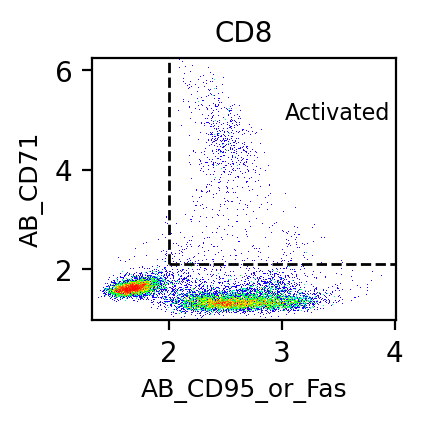

In [155]:
g1 = 'AB_CD95_or_Fas'
g2 = 'AB_CD71'   
# gating['Activated_CD8']
gating['Activated_CD8'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':2.1, 'hthresh':2, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.03,5, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD8.png'))
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD8.pdf'))

In [82]:
lineage = 'CD4'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [83]:
gating['Activated_CD4'].value_counts()

Series([], Name: Activated_CD4, dtype: int64)

Text(0.5, 1.0, 'CD4')

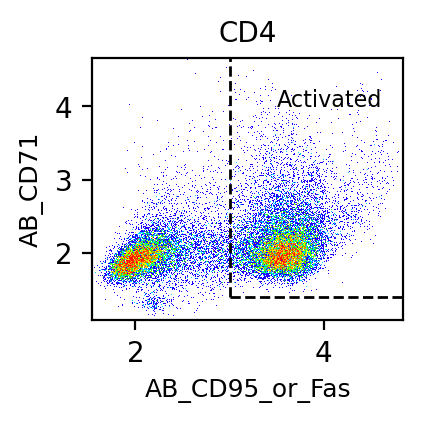

In [97]:
g1 = 'AB_CD95_or_Fas'
g2 = 'AB_CD71'   
gating['Activated_CD4'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.4, 'hthresh':3, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3.5,4, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD4.png'))
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_CD4.pdf'))

In [98]:
lineage = 'Other'
ind = lineage_gating.loc[markers_magic.index, 'class']==lineage

In [99]:
gating['Activated_Other'].value_counts()

Series([], Name: Activated_Other, dtype: int64)

Text(0.5, 1.0, 'Other')

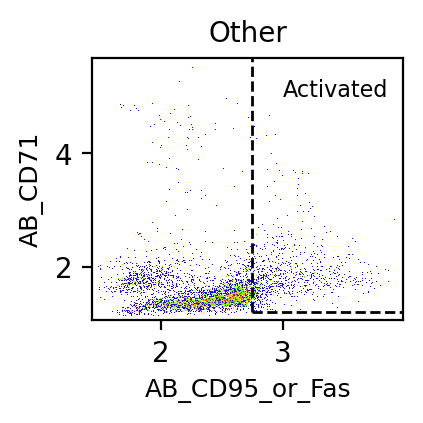

In [111]:
g1 = 'AB_CD95_or_Fas'
g2 = 'AB_CD71'   
gating['Activated_Other'], ax = gate(markers_magic, g1, g2, ind= ind,
                      quadrant_gate={'vthresh':1.2, 'hthresh':2.75, 'ur':'Activated', 'ul':'Unactivated', 'll':'Unactivated', 'lr':'Unactivated'}, 
                               plot_labeled=False, upper_only=True)
ax.text(3,5, 'Activated', fontsize=8)
ax.set_title(lineage, fontsize=10)
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_Other.png'))
# plt.savefig(os.path.join(figdir, 'ManualGatingActivation_Sparks_Other.pdf'))

In [162]:
gating['Activated_Other'].value_counts()

Unactivated    3859
Activated       904
Name: Activated_Other, dtype: int64

In [156]:
gating['Activated'] = np.nan

In [157]:
label = gating[['Activated_CD8', 'Activated_CD4', 'Activated_Other']].unstack().dropna().reset_index()
label.index = label['level_1']

In [158]:
gating.loc[label.index, 'Activated'] = label[0]

In [159]:
label.shape

(43222, 3)

In [160]:
len(label.index.unique())

43222

In [161]:
label.head()

,level_0,level_1,0
level_1,,,
3_AAACCTGCACAAGACG,Activated_CD8,3_AAACCTGCACAAGACG,Unactivated
3_AAACCTGCAGGATTGG,Activated_CD8,3_AAACCTGCAGGATTGG,Unactivated
3_AAACCTGCATGAACCT,Activated_CD8,3_AAACCTGCATGAACCT,Unactivated
3_AAACCTGCATTGCGGC,Activated_CD8,3_AAACCTGCATTGCGGC,Unactivated
3_AAACCTGTCCTTTACA,Activated_CD8,3_AAACCTGTCCTTTACA,Unactivated


In [119]:
(gating.isna().sum(axis = 1)==2).value_counts()

True    43222
dtype: int64

In [163]:
gating

,Activated_CD8,Activated_CD4,Activated_Other,Class,Activated
3_AAACCTGAGACCGGAT,NaN,Activated,NaN,CD4,Activated
3_AAACCTGAGAGGGCTT,NaN,Unactivated,NaN,CD4,Unactivated
3_AAACCTGAGAGTCTGG,NaN,Activated,NaN,CD4,Activated
3_AAACCTGAGCTAGCCC,NaN,Unactivated,NaN,CD4,Unactivated
3_AAACCTGAGCTGCCCA,NaN,Activated,NaN,CD4,Activated
...,...,...,...,...,...
2_TTTGTCATCAGGCCCA,NaN,Activated,NaN,CD4,Activated
2_TTTGTCATCATATCGG,NaN,NaN,Activated,Other,Activated
2_TTTGTCATCATTATCC,NaN,NaN,Unactivated,Other,Unactivated
2_TTTGTCATCGGCTACG,NaN,Unactivated,NaN,CD4,Unactivated


In [164]:
gating['Activated'].value_counts()

Unactivated    27165
Activated      16057
Name: Activated, dtype: int64

In [165]:
gating[['Class', 'Activated']].value_counts()

Class  Activated  
CD4    Activated      14313
CD8    Unactivated    12564
CD4    Unactivated    10742
Other  Unactivated     3859
       Activated        904
CD8    Activated        840
dtype: int64

In [166]:
outfn = os.path.join(outdir, 'ManualGatingActivationByLineage.Magic.20230112.tsv')
print(outfn)

../../../Data/PerDataset/Stimseq/ManualGatingActivationByLineage.Magic.20230112.tsv


In [167]:
gating[['Class', 'Activated']].to_csv(outfn, sep='\t')

In [168]:
gating

,Activated_CD8,Activated_CD4,Activated_Other,Class,Activated
3_AAACCTGAGACCGGAT,NaN,Activated,NaN,CD4,Activated
3_AAACCTGAGAGGGCTT,NaN,Unactivated,NaN,CD4,Unactivated
3_AAACCTGAGAGTCTGG,NaN,Activated,NaN,CD4,Activated
3_AAACCTGAGCTAGCCC,NaN,Unactivated,NaN,CD4,Unactivated
3_AAACCTGAGCTGCCCA,NaN,Activated,NaN,CD4,Activated
...,...,...,...,...,...
2_TTTGTCATCAGGCCCA,NaN,Activated,NaN,CD4,Activated
2_TTTGTCATCATATCGG,NaN,NaN,Activated,Other,Activated
2_TTTGTCATCATTATCC,NaN,NaN,Unactivated,Other,Unactivated
2_TTTGTCATCGGCTACG,NaN,Unactivated,NaN,CD4,Unactivated


In [169]:
gating.loc[adata_ADT.obs.index, 'Activated'].groupby(adata_ADT.obs['Sort_Status']).value_counts()

Sort_Status  Activated  
+            Activated       8429
             Unactivated     4806
-            Unactivated    11633
             Activated       3895
U            Unactivated    10726
             Activated       3733
Name: Activated, dtype: int64

# Cluster on non-smoothed markers by lineage

In [101]:
harmony_vars = ['Run', 'Biobank_ID']

In [13]:
adt_markers

['AB_CD134_or_OX40',
 'AB_CD71',
 'AB_CD95_or_Fas',
 'AB_CD54',
 'AB_CD25',
 'AB_CD274_or_B7-H1_PD-L1',
 'AB_CD69']

Do 3 ways:
1. Cluster all cells at once
2. Cluster 3x (CD4, CD8, Other)
3. Harmonize over lineage

## All cells

In [104]:
adata_ADT_filt = adata_ADT[:, adt_markers].copy()

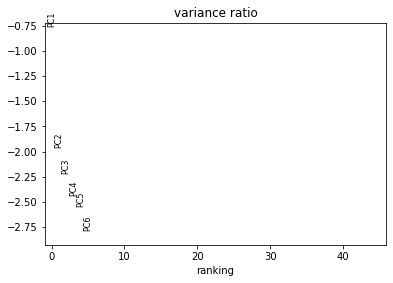

In [105]:
sc.tl.pca(adata_ADT_filt, zero_center=True)
sc.pl.pca_variance_ratio(adata_ADT_filt, log=True, n_pcs=45)

In [106]:
adata_ADT_filt.obsm['X_pca'].shape

(43222, 6)

In [107]:
adata_ADT_filt.obs[harmony_vars] = adata_ADT_filt.obs[harmony_vars].astype(str)

In [113]:
adata_ADT_filt.obs[harmony_vars]

,Run,Biobank_ID
3_AAACCTGAGACCGGAT,2,10042029
3_AAACCTGAGAGGGCTT,2,10057029
3_AAACCTGAGAGTCTGG,2,10049452
3_AAACCTGAGCTAGCCC,2,10042029
3_AAACCTGAGCTGCCCA,2,10057029
...,...,...
2_TTTGTCATCAGGCCCA,1,10049452
2_TTTGTCATCATATCGG,1,10057029
2_TTTGTCATCATTATCC,1,10057029
2_TTTGTCATCGGCTACG,1,10049452


In [108]:
sc.external.pp.harmony_integrate(adata_ADT_filt,  harmony_vars, max_iter_harmony = 30)

2024-01-30 14:57:00,901 - harmonypy - INFO - Iteration 1 of 30
2024-01-30 14:57:17,501 - harmonypy - INFO - Iteration 2 of 30
2024-01-30 14:57:33,859 - harmonypy - INFO - Iteration 3 of 30
2024-01-30 14:57:50,080 - harmonypy - INFO - Iteration 4 of 30
2024-01-30 14:58:06,250 - harmonypy - INFO - Iteration 5 of 30
2024-01-30 14:58:22,640 - harmonypy - INFO - Iteration 6 of 30
2024-01-30 14:58:39,302 - harmonypy - INFO - Iteration 7 of 30
2024-01-30 14:58:53,958 - harmonypy - INFO - Iteration 8 of 30
2024-01-30 14:59:05,711 - harmonypy - INFO - Iteration 9 of 30
2024-01-30 14:59:16,796 - harmonypy - INFO - Iteration 10 of 30
2024-01-30 14:59:26,078 - harmonypy - INFO - Iteration 11 of 30
2024-01-30 14:59:37,106 - harmonypy - INFO - Converged after 11 iterations


In [109]:
sc.pp.neighbors(adata_ADT_filt, n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
sc.tl.umap(adata_ADT_filt)
adata_ADT_filt.obsm['X_ADT_UMAP'] = adata_ADT_filt.obsm['X_umap']
for res in np.arange(0.2, 1.2, 0.2):
    print(res)
    sc.tl.leiden(adata_ADT_filt, resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))

0.2
0.4
0.6000000000000001
0.8
1.0


In [110]:
adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')]

Index(['leiden_0_20', 'leiden_0_40', 'leiden_0_60', 'leiden_0_80',
       'leiden_1_00'],
      dtype='object')

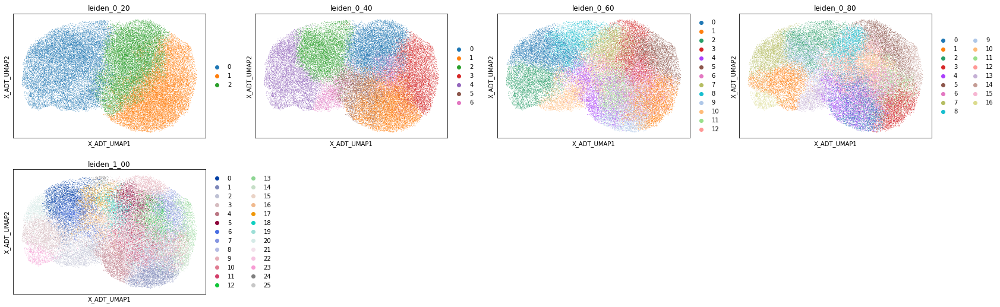

In [111]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', 
                color = adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')])


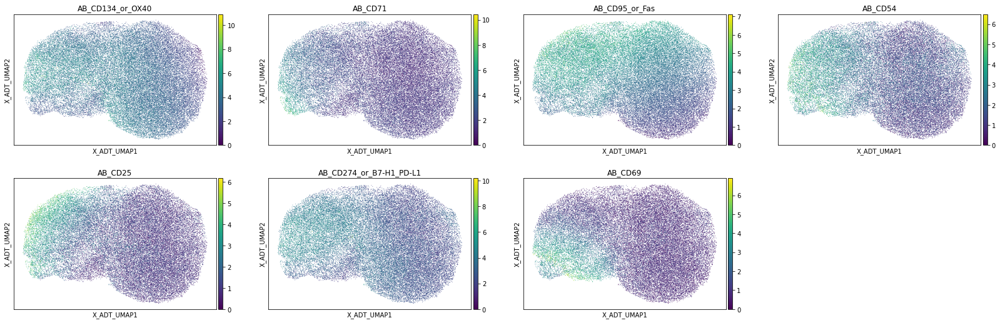

In [112]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = adt_markers)

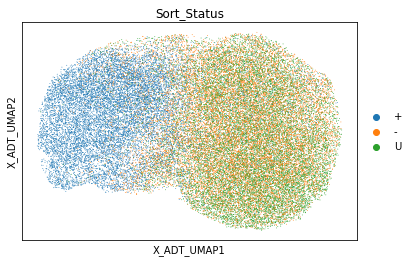

In [204]:
sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = 'Sort_Status')

In [226]:
act_clusters_all['All_Cells'] = ('leiden_0_20', ['0'])

In [130]:
adata_ADT_filt.obsm['X_umap']

array([[ 3.8357706,  8.982565 ],
       [13.524711 ,  2.7357388],
       [-3.1425965,  5.6029277],
       ...,
       [ 9.509825 ,  1.5385967],
       [ 6.5708146,  1.390312 ],
       [ 2.3211699,  3.3143103]], dtype=float32)

In [135]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_All.h5ad')
print(outfn)

../../../Data/PerDataset/Stimseq/ADT_TP10KCLR_ClusterActivation_All.h5ad


In [139]:
sc.write(filename = outfn, adata = adata_ADT_filt)

In [49]:
# sc.pp.neighbors(adata_ADT_filt, n_neighbors=10, n_pcs=6, use_rep='X_pca')
# sc.tl.umap(adata_ADT_filt)
# adata_ADT_filt.obsm['X_ADT_UMAP'] = adata_ADT_filt.obsm['X_umap']
# for res in np.arange(0.2, 1.2, 0.2):
#     print(res)
#     sc.tl.leiden(adata_ADT_filt, resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))

# adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')]

# sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', 
#                 color = adata_ADT_filt.obs.columns[adata_ADT_filt.obs.columns.str.contains('leiden')])


# sc.pl.embedding(adata_ADT_filt, basis = 'X_ADT_UMAP', color = adt_markers)

## By lineage classes

In [114]:
adata_lineages = {}

CD4


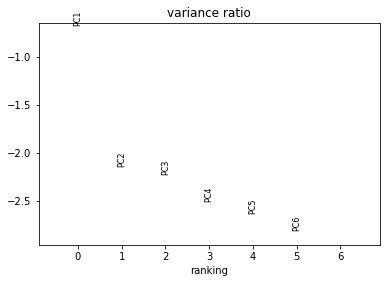

2024-01-30 15:01:29,880 - harmonypy - INFO - Iteration 1 of 30
2024-01-30 15:01:39,111 - harmonypy - INFO - Iteration 2 of 30
2024-01-30 15:01:48,982 - harmonypy - INFO - Iteration 3 of 30
2024-01-30 15:01:58,689 - harmonypy - INFO - Iteration 4 of 30
2024-01-30 15:02:08,144 - harmonypy - INFO - Iteration 5 of 30
2024-01-30 15:02:17,773 - harmonypy - INFO - Converged after 5 iterations


0.2
0.4
0.6000000000000001
0.8
1.0
Other


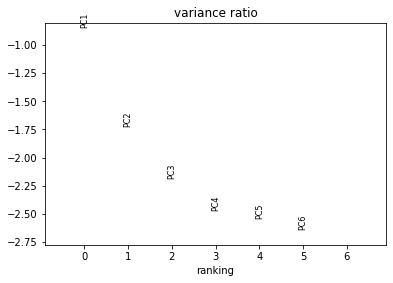

2024-01-30 15:02:58,971 - harmonypy - INFO - Iteration 1 of 30
2024-01-30 15:03:00,752 - harmonypy - INFO - Iteration 2 of 30
2024-01-30 15:03:02,589 - harmonypy - INFO - Iteration 3 of 30
2024-01-30 15:03:04,285 - harmonypy - INFO - Iteration 4 of 30
2024-01-30 15:03:06,061 - harmonypy - INFO - Iteration 5 of 30
2024-01-30 15:03:07,845 - harmonypy - INFO - Iteration 6 of 30
2024-01-30 15:03:09,571 - harmonypy - INFO - Iteration 7 of 30
2024-01-30 15:03:10,915 - harmonypy - INFO - Iteration 8 of 30
2024-01-30 15:03:12,623 - harmonypy - INFO - Iteration 9 of 30
2024-01-30 15:03:13,507 - harmonypy - INFO - Iteration 10 of 30
2024-01-30 15:03:14,547 - harmonypy - INFO - Iteration 11 of 30
2024-01-30 15:03:15,430 - harmonypy - INFO - Iteration 12 of 30
2024-01-30 15:03:16,232 - harmonypy - INFO - Iteration 13 of 30
2024-01-30 15:03:16,954 - harmonypy - INFO - Iteration 14 of 30
2024-01-30 15:03:17,755 - harmonypy - INFO - Iteration 15 of 30
2024-01-30 15:03:18,715 - harmonypy - INFO - Conv

0.2
0.4
0.6000000000000001
0.8
1.0
CD8


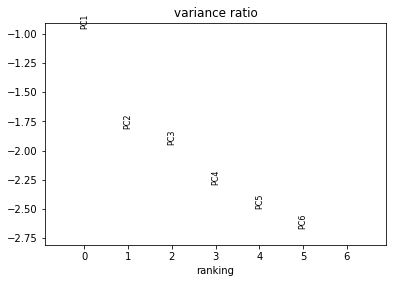

2024-01-30 15:03:34,457 - harmonypy - INFO - Iteration 1 of 30
2024-01-30 15:03:39,875 - harmonypy - INFO - Iteration 2 of 30
2024-01-30 15:03:45,170 - harmonypy - INFO - Iteration 3 of 30
2024-01-30 15:03:50,426 - harmonypy - INFO - Iteration 4 of 30
2024-01-30 15:03:56,063 - harmonypy - INFO - Iteration 5 of 30
2024-01-30 15:04:01,374 - harmonypy - INFO - Iteration 6 of 30
2024-01-30 15:04:06,773 - harmonypy - INFO - Iteration 7 of 30
2024-01-30 15:04:11,935 - harmonypy - INFO - Iteration 8 of 30
2024-01-30 15:04:15,970 - harmonypy - INFO - Iteration 9 of 30
2024-01-30 15:04:19,808 - harmonypy - INFO - Iteration 10 of 30
2024-01-30 15:04:23,638 - harmonypy - INFO - Iteration 11 of 30
2024-01-30 15:04:27,738 - harmonypy - INFO - Iteration 12 of 30
2024-01-30 15:04:31,942 - harmonypy - INFO - Iteration 13 of 30
2024-01-30 15:04:35,487 - harmonypy - INFO - Iteration 14 of 30
2024-01-30 15:04:39,002 - harmonypy - INFO - Iteration 15 of 30
2024-01-30 15:04:41,896 - harmonypy - INFO - Iter

0.2
0.4
0.6000000000000001
0.8
1.0


In [115]:
for lineage in lineage_gating['class'].unique():
    print(lineage)
    
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    adata_lineages[lineage] = adata_ADT[ind_lineage, adt_markers].copy()
    
    sc.tl.pca(adata_lineages[lineage], zero_center=True)
    sc.pl.pca_variance_ratio(adata_lineages[lineage], log=True, n_pcs=6)

    adata_lineages[lineage].obs[harmony_vars] = adata_lineages[lineage].obs[harmony_vars].astype(str)
    sc.external.pp.harmony_integrate(adata_lineages[lineage],  harmony_vars, max_iter_harmony = 30)

    sc.pp.neighbors(adata_lineages[lineage], n_neighbors=10, n_pcs=6, use_rep='X_pca_harmony')
    sc.tl.umap(adata_lineages[lineage])
    adata_lineages[lineage].obsm['X_ADT_UMAP'] = adata_lineages[lineage].obsm['X_umap']
    for res in np.arange(0.2, 1.2, 0.2):
        print(res)
        sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))
        
    

In [ ]:
# for res in [0.3]:
#     print(res)
#     sc.tl.leiden(adata_lineages[lineage], resolution=res, key_added='leiden_%s' % ('%.2f' % res).replace('.', '_'))



0.3


In [159]:
act_clusters_all = {}

In [183]:
lineage  = 'CD4'

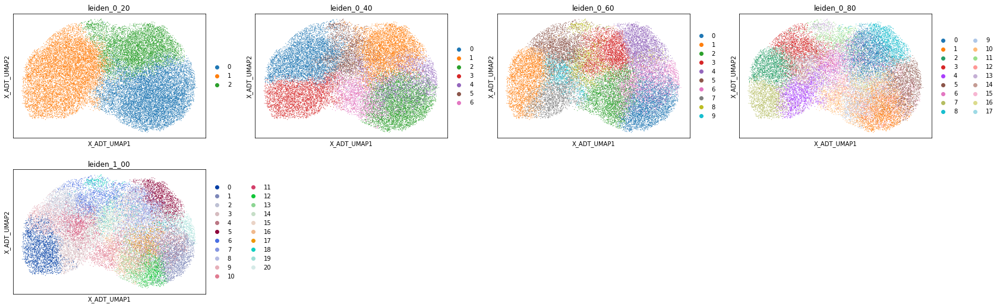

In [118]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


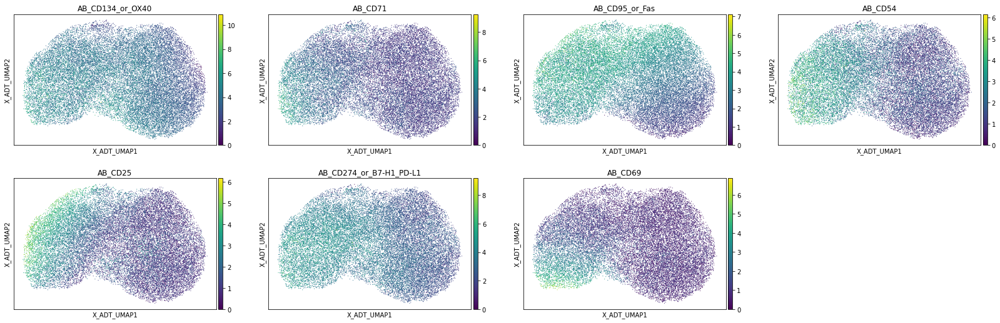

In [119]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

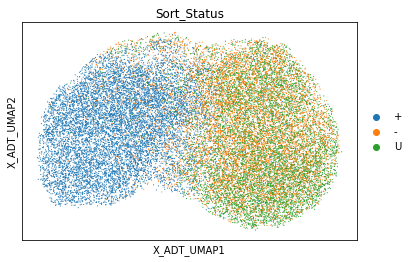

In [120]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = 'Sort_Status')


In [184]:
act_clusters_all[lineage] = ('leiden_0_20', ['1'])

In [161]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

3_AAACCTGAGACCGGAT    False
3_AAACCTGAGAGGGCTT    False
3_AAACCTGAGAGTCTGG    False
3_AAACCTGAGCTAGCCC    False
3_AAACCTGAGCTGCCCA    False
                      ...  
2_TTTGTCAGTATCACCA    False
2_TTTGTCAGTGTCGCTG    False
2_TTTGTCAGTTCCACTC    False
2_TTTGTCATCAGGCCCA    False
2_TTTGTCATCGGCTACG    False
Name: leiden_0_20, Length: 25055, dtype: bool

In [141]:
lineage

'CD4'

In [142]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage)
print(outfn)

../../../Data/PerDataset/Stimseq/ADT_TP10KCLR_ClusterActivation_CD4.h5ad


In [143]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

In [185]:
lineage  = 'CD8'

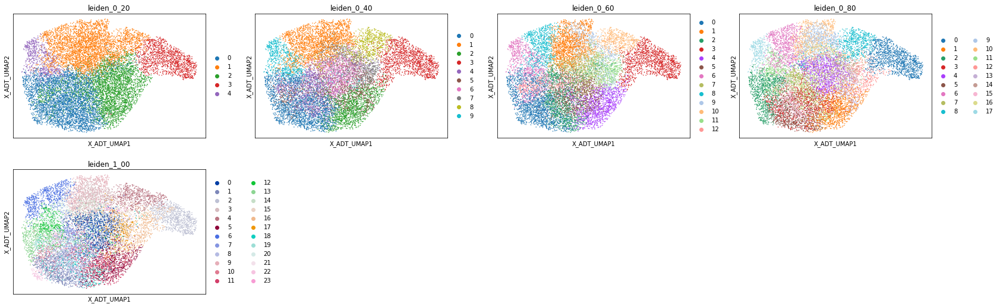

In [122]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


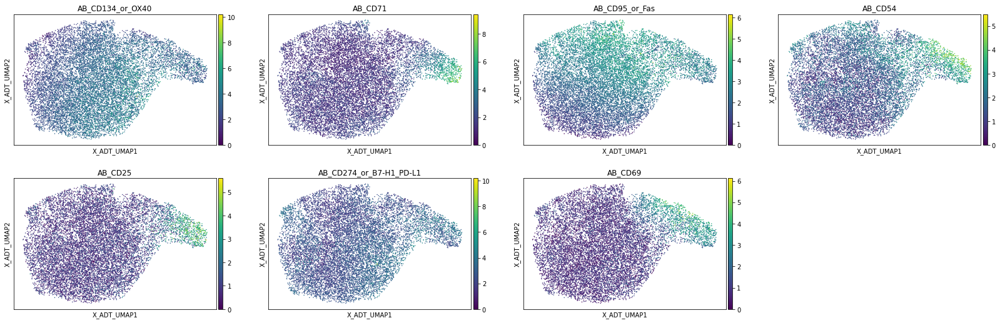

In [123]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

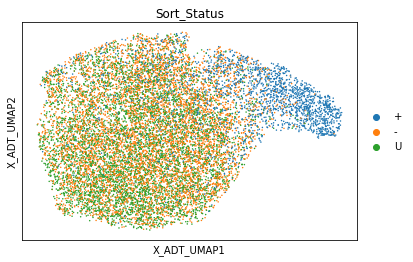

In [124]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = 'Sort_Status')


In [186]:
act_clusters_all[lineage] = ('leiden_0_20', ['3'])

In [164]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

3_AAACCTGCACAAGACG    False
3_AAACCTGCAGGATTGG    False
3_AAACCTGCATGAACCT    False
3_AAACCTGCATTGCGGC    False
3_AAACCTGTCCTTTACA    False
                      ...  
2_TTTGGTTCAGGAATCG    False
2_TTTGGTTCATTCTCAT    False
2_TTTGGTTTCGGATGGA    False
2_TTTGGTTTCGTGGACC    False
2_TTTGTCAAGGCTCTTA    False
Name: leiden_0_20, Length: 13404, dtype: bool

In [145]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage)
print(outfn)

../../../Data/PerDataset/Stimseq/ADT_TP10KCLR_ClusterActivation_CD8.h5ad


In [146]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

In [187]:
lineage  = 'Other'

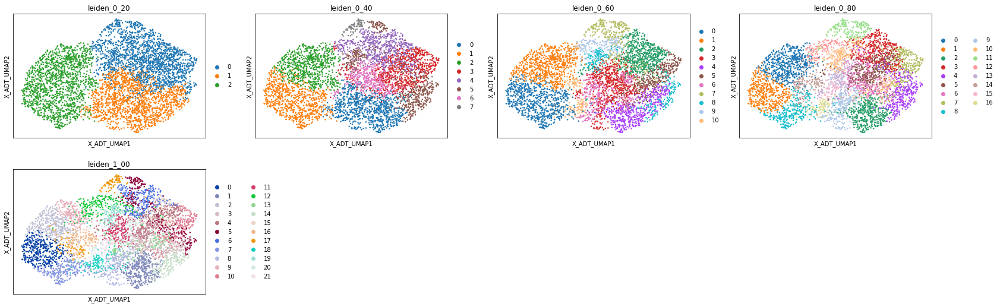

In [126]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', 
                color = adata_lineages[lineage].obs.columns[adata_lineages[lineage].obs.columns.str.contains('leiden')])


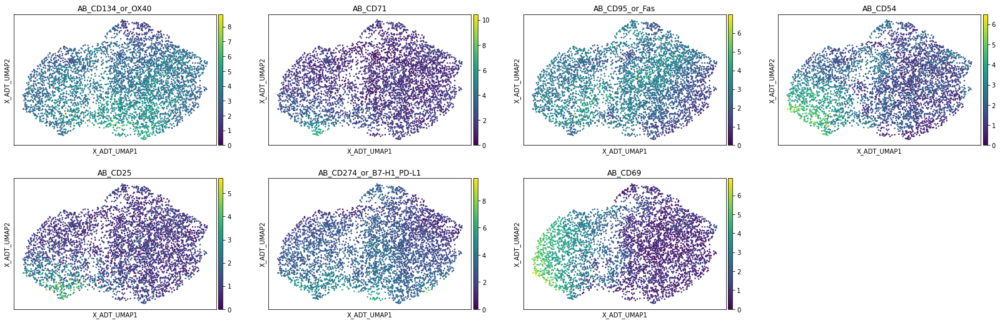

In [127]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = adt_markers)

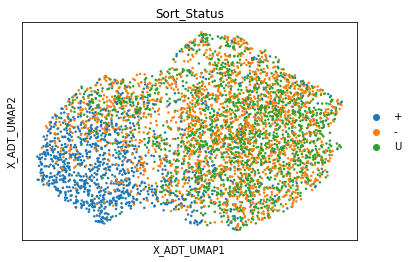

In [128]:
sc.pl.embedding(adata_lineages[lineage], basis = 'X_ADT_UMAP', color = 'Sort_Status')


In [188]:
act_clusters_all[lineage] = ('leiden_0_40', ['1'])

In [171]:
adata_lineages[lineage].obs[act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

3_AAACCTGCAAGCCCAC    False
3_AAACCTGGTTTGTGTG    False
3_AAACGGGGTCGCATAT    False
3_AAACGGGTCTAACTGG    False
3_AAACGGGTCTGAGTGT    False
                      ...  
2_TTTGGTTCACCCTATC    False
2_TTTGGTTGTCCATCCT    False
2_TTTGTCATCATATCGG    False
2_TTTGTCATCATTATCC    False
2_TTTGTCATCTCCAGGG    False
Name: leiden_0_40, Length: 4763, dtype: bool

In [148]:
outfn = os.path.join(outdir, 'ADT_TP10KCLR_ClusterActivation_%s.h5ad' % lineage)
print(outfn)

../../../Data/PerDataset/Stimseq/ADT_TP10KCLR_ClusterActivation_Other.h5ad


In [149]:
sc.write(filename = outfn, adata = adata_lineages[lineage])

## Output labels

In [210]:
output = pd.DataFrame(columns = ['Activation_Cluster_ByLineage', 'Activation_Cluster_All'],
             index = adata_ADT.obs.index)

In [216]:
for lineage in lineage_gating['class'].unique():
    output.loc[adata_lineages[lineage].obs.index, 'Activation_Cluster_ByLineage'] = adata_lineages[lineage].obs[
        act_clusters_all[lineage][0]].isin(act_clusters_all[lineage][1])

In [233]:
output['Activation_Cluster_All'] = adata_ADT_filt.obs.loc[
    output.index, act_clusters_all['All_Cells'][0]].isin(act_clusters_all['All_Cells'][1])



In [234]:
output

,Activation_Cluster_ByLineage,Activation_Cluster_All
3_AAACCTGAGACCGGAT,True,True
3_AAACCTGAGAGGGCTT,False,False
3_AAACCTGAGAGTCTGG,True,True
3_AAACCTGAGCTAGCCC,False,False
3_AAACCTGAGCTGCCCA,True,True
...,...,...
2_TTTGTCATCAGGCCCA,False,False
2_TTTGTCATCATATCGG,False,True
2_TTTGTCATCATTATCC,False,False
2_TTTGTCATCGGCTACG,False,False


In [246]:
pd.crosstab(adata_ADT.obs['Sort_Status'], 
           [lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineage']])

class                          CD4         CD8       Other     
Activation_Cluster_ByLineage False  True False  True False True
Sort_Status                                                    
+                             1484  8441  1035  1152   497  626
-                             6920   673  5897   146  1774  118
U                             7322   215  5126    48  1733   15

In [236]:
outfn = os.path.join(outdir, 'ActivationByClustering.tsv')
print(outfn)

../../../Data/PerDataset/Stimseq/ActivationByClustering.tsv


In [237]:
output.to_csv(outfn, sep='\t')

In [615]:
output

,Activation_Cluster_ByLineage,Activation_Cluster_All
3_AAACCTGAGACCGGAT,True,True
3_AAACCTGAGAGGGCTT,False,False
3_AAACCTGAGAGTCTGG,True,True
3_AAACCTGAGCTAGCCC,False,False
3_AAACCTGAGCTGCCCA,True,True
...,...,...
2_TTTGTCATCAGGCCCA,False,False
2_TTTGTCATCATATCGG,False,True
2_TTTGTCATCATTATCC,False,False
2_TTTGTCATCGGCTACG,False,False


In [391]:
pd.crosstab(adata_ADT.obs['Sort_Status'], 
           [lineage_gating.loc[adata_ADT.obs.index, 'class'],
           output.loc[adata_ADT.obs.index, 'Activation_Cluster_ByLineage']])

class                          CD4         CD8       Other     
Activation_Cluster_ByLineage False  True False  True False True
Sort_Status                                                    
+                             1484  8441  1035  1152   497  626
-                             6920   673  5897   146  1774  118
U                             7322   215  5126    48  1733   15

## Plot ADT/cluster heatmaps

In [255]:
for lineage in lineage_gating['class'].unique():
    print(lineage)

CD4
Other
CD8


In [321]:
adata_ADT_plot = sc.pp.scale(adata_ADT, zero_center=True, copy = True)


In [341]:
vmax = np.quantile(abs(adata_ADT_plot[:, adt_markers].X), 0.95)#adata_ADT_plot[:, adt_markers].X.max()
vmin = -vmax #adata_ADT_plot[:, adt_markers].X.min()

vmin, vmax

(-1.9912528514862038, 1.9912528514862038)

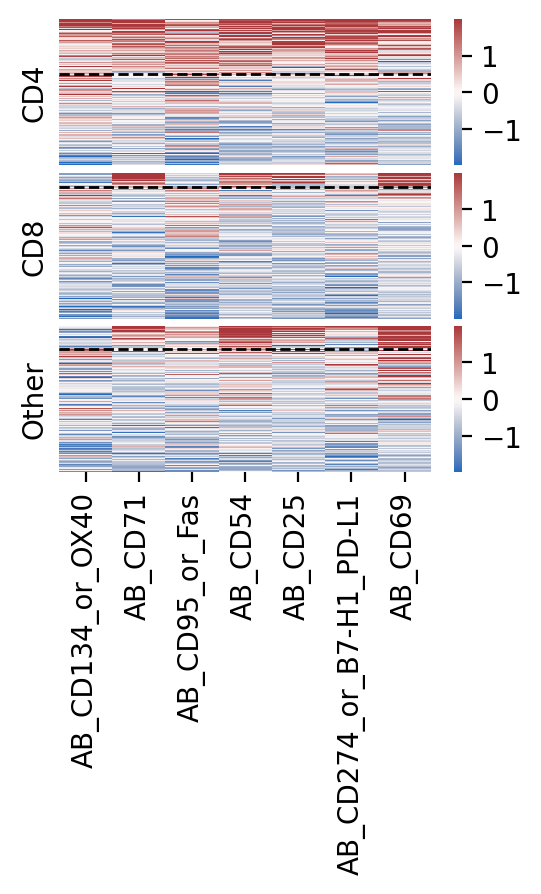

In [384]:
nrows = len(lineage_gating['class'].unique())

fig, axes = plt.subplots(dpi = 200, nrows = nrows, ncols = 1, figsize = (3, 3), 
                         gridspec_kw = {'hspace' : 0.05})

all_order = []
for i, lineage in enumerate(['CD4', 'CD8', 'Other']):

    ax = axes[i]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    
    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    
    ind_order = g1 + g2
    all_order += ind_order

    # ind_order = output.loc[ind_lineage, 'Activation_Cluster_ByLineage'].sort_values(ascending = False).index
    
    # if i ==0:
    #     cbar = True
    # else:
    #     cbar = False
    sns.heatmap(adata_ADT_plot[ind_order, adt_markers].X, cmap = 'vlag', 
                ax = ax, vmin = vmin, vmax = vmax)
    ax.set_yticks([])
    ax.set_ylabel(lineage)
    
    ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_markers), color = 'black', 
              linestyle = 'dashed', linewidth = 1)
    
    if i == (nrows-1):
        ax.set_xticklabels(adt_markers, rotation = 90)
    else:
        ax.set_xticks([])


In [ ]:
row_colors

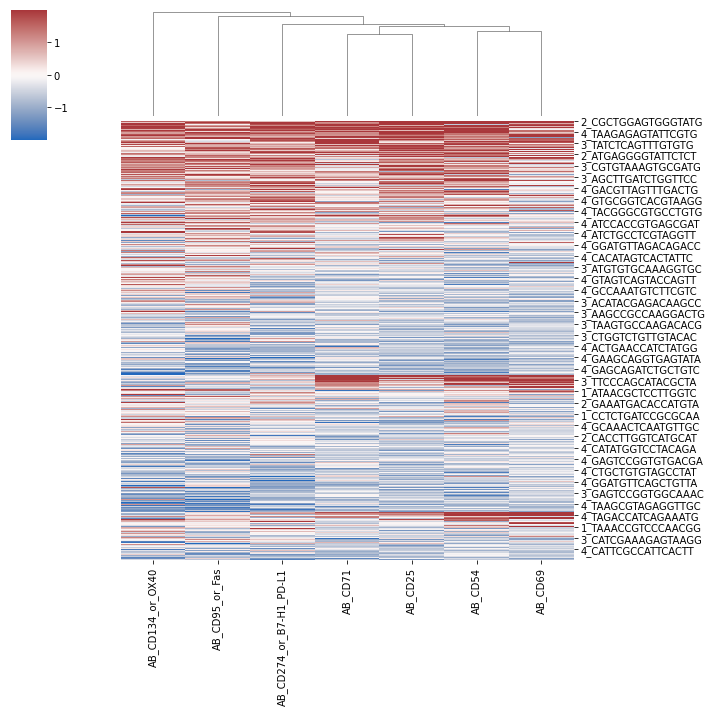

In [405]:
g = sns.clustermap(pd.DataFrame(adata_ADT_plot[all_order, adt_markers].X, index = all_order,
                            columns = adt_markers), row_cluster = False, vmin = vmin, vmax = vmax,
               cmap = 'vlag')

In [412]:
adt_order = list(pd.Series(adt_markers)[g.dendrogram_col.reordered_ind])

In [413]:
adt_order

['AB_CD134_or_OX40',
 'AB_CD95_or_Fas',
 'AB_CD274_or_B7-H1_PD-L1',
 'AB_CD71',
 'AB_CD25',
 'AB_CD54',
 'AB_CD69']

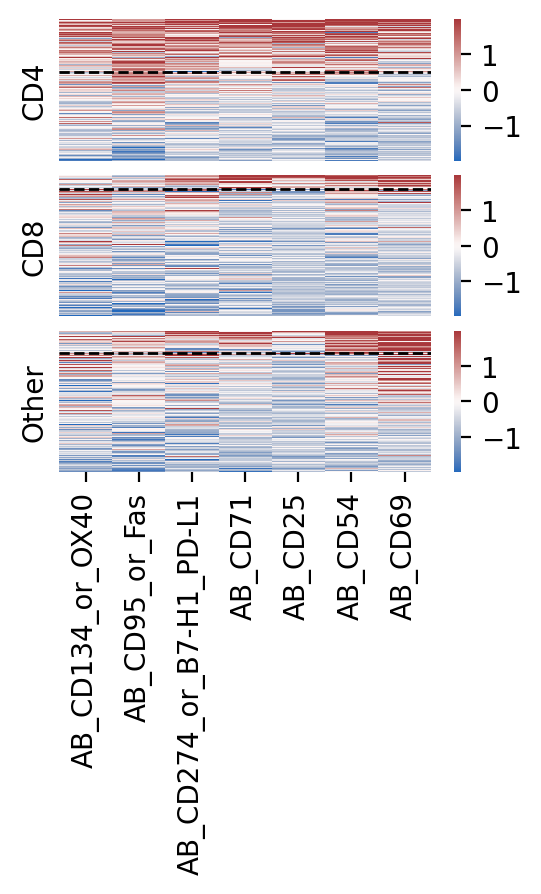

In [417]:
nrows = len(lineage_gating['class'].unique())

fig, axes = plt.subplots(dpi = 200, nrows = nrows, ncols = 1, figsize = (3, 3), 
                         gridspec_kw = {'hspace' : 0.1})

all_order = []
for i, lineage in enumerate(['CD4', 'CD8', 'Other']):

    ax = axes[i]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
    
    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_order].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_order].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    
    ind_order = g1 + g2
    all_order += ind_order

    # ind_order = output.loc[ind_lineage, 'Activation_Cluster_ByLineage'].sort_values(ascending = False).index
    
    # if i ==0:
    #     cbar = True
    # else:
    #     cbar = False
    sns.heatmap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
                ax = ax, vmin = vmin, vmax = vmax)
    ax.set_yticks([])
    ax.set_ylabel(lineage)
    
    ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_order), color = 'black', 
              linestyle = 'dashed', linewidth = 1)
    
    if i == (nrows-1):
        ax.set_xticklabels(adt_order, rotation = 90)
    else:
        ax.set_xticks([])


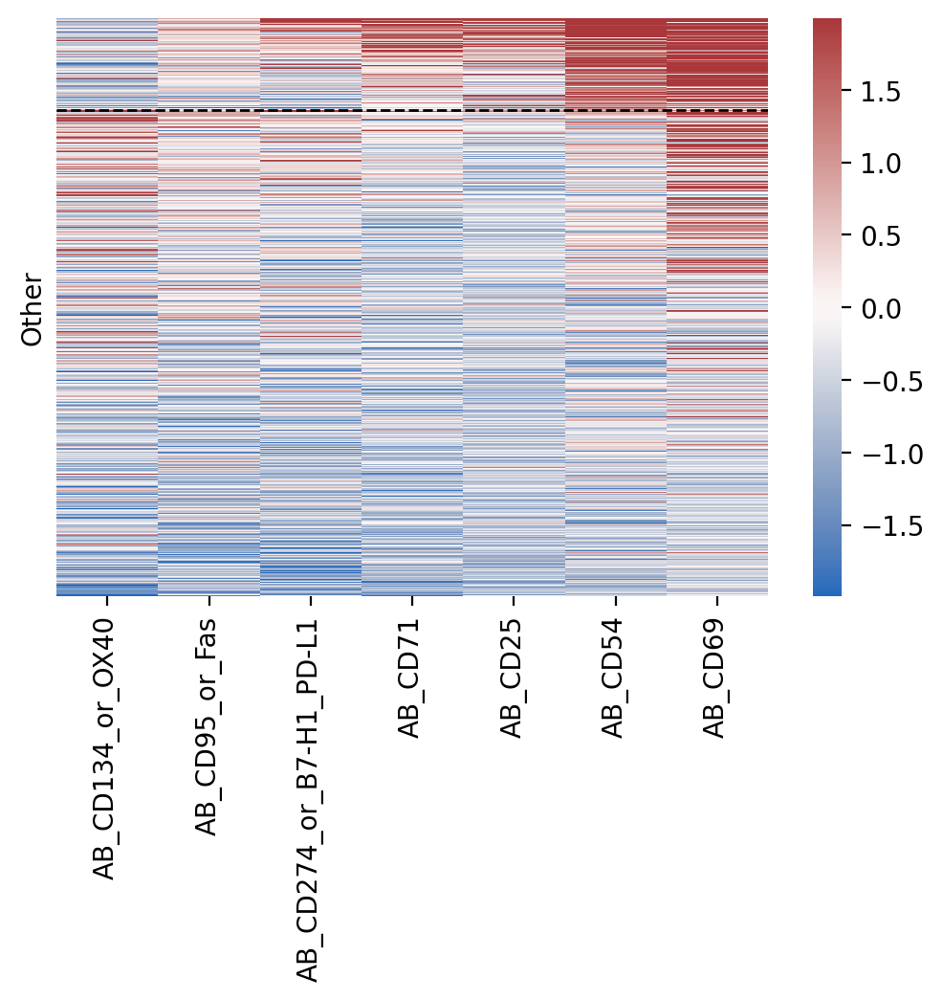

In [418]:
fig, ax = plt.subplots(dpi =200)

sns.heatmap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
            ax = ax, vmin = vmin, vmax = vmax, )
ax.set_yticks([])
ax.set_ylabel(lineage)

ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_order), color = 'black', 
          linestyle = 'dashed', linewidth = 1)

if i == (nrows-1):
    ax.set_xticklabels(adt_order, rotation = 90)
else:
    ax.set_xticks([])

    

In [443]:
# palette = sns.color_palette("husl")

# palette = sns.color_palette("BuPu_r")

In [548]:
adata_lineages[lineage].uns['%s_colors' % cluster_col]

['#1f77b4',
 '#ff7f0e',
 '#2ca02c',
 '#d62728',
 '#9467bd',
 '#8c564b',
 '#e377c2',
 '#7f7f7f']

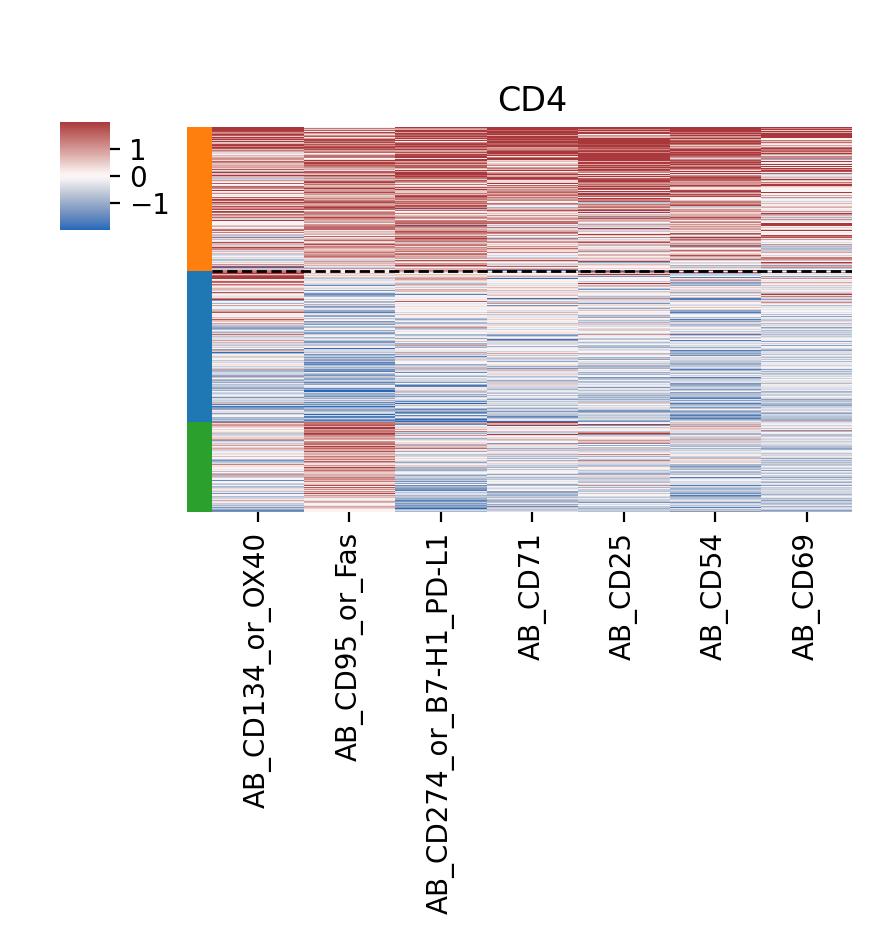

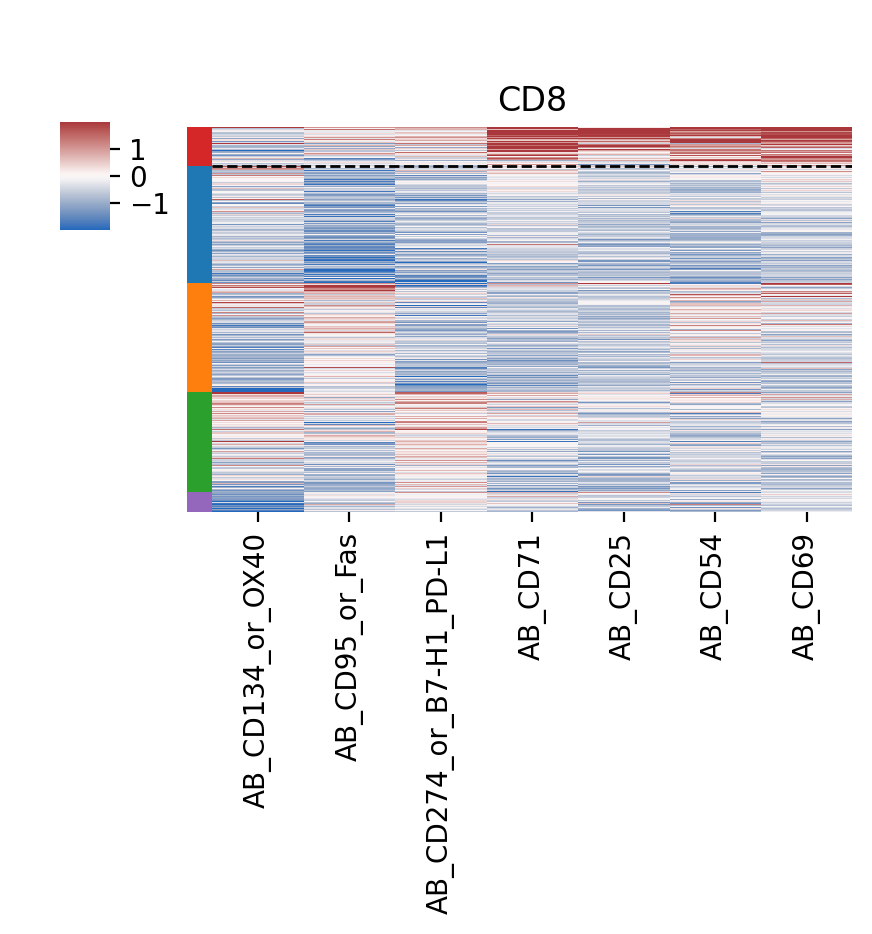

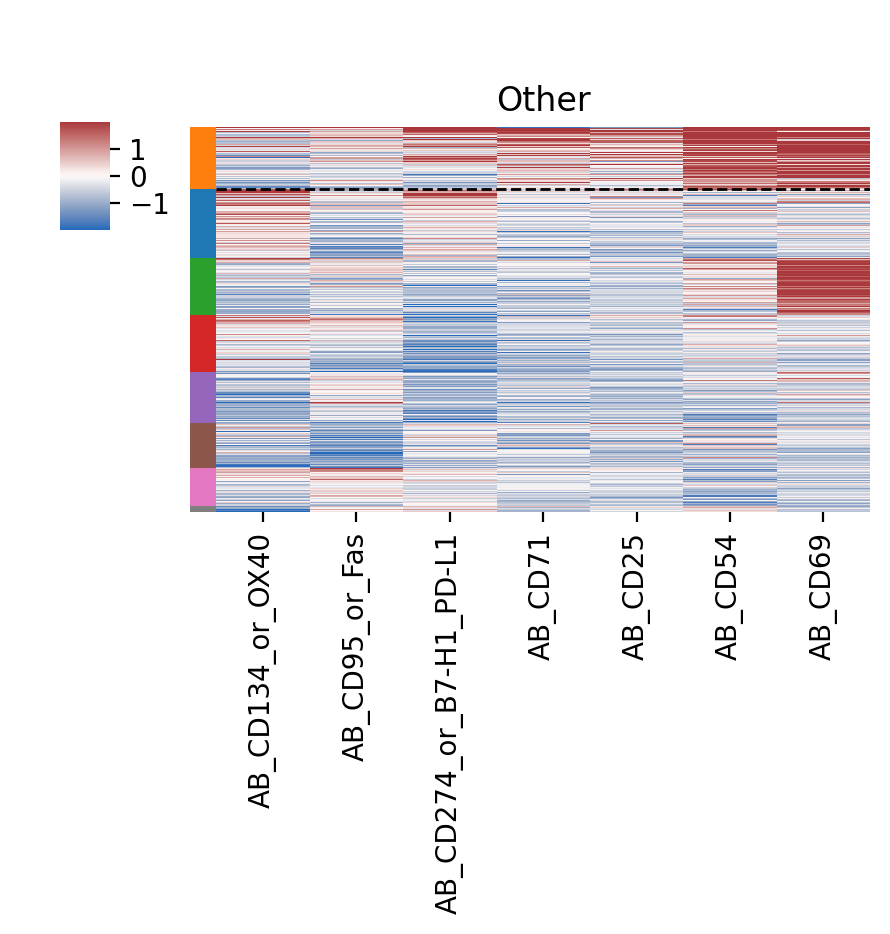

In [561]:
for i, lineage in enumerate(['CD4', 'CD8', 'Other']):


    cluster_col = act_clusters_all[lineage][0]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index

    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    # ind_order = g1 + g2
    # Sort within clusters
    g2_order = pd.DataFrame(adata_lineages[lineage].obs.loc[g2, cluster_col], index = g2)
    g2_order['mean_adt'] = adata_ADT_plot[g2, adt_markers].X.mean(axis = 1)
    g2_final = list(g2_order.sort_values([cluster_col, 'mean_adt'], ascending = [True, False]).index)
    ind_order = g1 + g2_final

    # palette = sns.color_palette("tab20",
    #              n_colors = len(adata_lineages[lineage].obs.loc[ind_order, cluster_col].unique()))
    figsize = (5, 3)

    with rc_context({"figure.dpi" : 200}):

        g = sns.clustermap(adata_ADT_plot[ind_order, adt_order].X, cmap = 'vlag', 
                       row_colors = [adata_lineages[lineage].uns['%s_colors' % cluster_col][i]# palette[i] 
                                     for i in 
                                     adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int')],
                           figsize = figsize,
                       vmin = vmin, vmax = vmax, row_cluster = False, col_cluster = False,
                                      cbar_pos=(0.07, 0.6, 0.05, 0.18))


        ax = g.ax_heatmap
        ax.hlines(y = len(g1), xmin = 0, xmax = len(adt_markers), color = 'black', 
                  linestyle = 'dashed', linewidth = 1 )
        ax.set_yticks([])
        ax.set_xticklabels(adt_order, rotation = 90)
        ax.set_title(lineage)

In [574]:
all_order = []
all_clusters = []
n_clusters = 0
for i, lineage in enumerate(['CD4', 'CD8', 'Other']):
    
    cluster_col = act_clusters_all[lineage][0]
    ind_lineage = lineage_gating[lineage_gating['class']==lineage].index

    g1 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==True]
    g2 = ind_lineage[output.loc[ind_lineage, 'Activation_Cluster_ByLineage']==False]
    g1 = list(pd.Series(adata_ADT_plot[g1, adt_markers].X.mean(axis = 1), index = g1).sort_values(ascending = False).index)
    g2 = list(pd.Series(adata_ADT_plot[g2, adt_markers].X.mean(axis = 1), index = g2).sort_values(ascending = False).index)
    # ind_order = g1 + g2
    # Sort within clusters
    g2_order = pd.DataFrame(adata_lineages[lineage].obs.loc[g2, cluster_col], index = g2)
    g2_order['mean_adt'] = adata_ADT_plot[g2, adt_markers].X.mean(axis = 1)
    g2_final = list(g2_order.sort_values([cluster_col, 'mean_adt'], ascending = [True, False]).index)
    ind_order = g1 + g2_final
    
    all_order += ind_order
    all_clusters += list(adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int') + n_clusters)
    n_clusters += len(adata_lineages[lineage].obs.loc[ind_order, cluster_col].astype('int').unique())


In [576]:
set(all_clusters)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15}

In [577]:
palette = sns.color_palette("tab20",
             n_colors = len(set(all_clusters)))


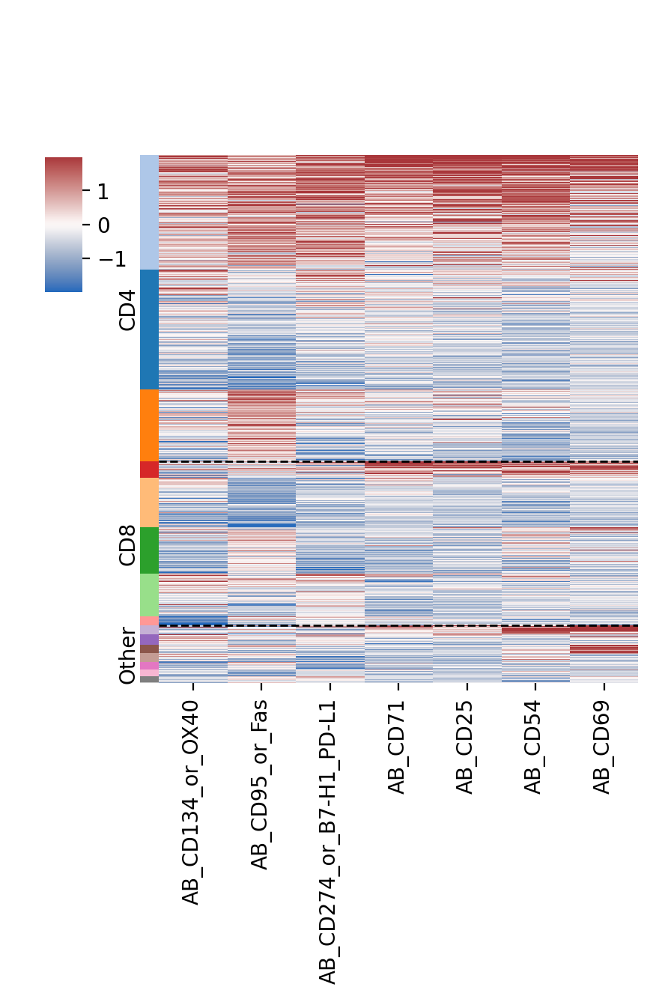

In [614]:

figsize = (5, 5)

with rc_context({"figure.dpi" : 200}):

    g = sns.clustermap(adata_ADT_plot[all_order, adt_order].X, cmap = 'vlag', 
           row_colors =  [palette[i] 
                         for i in all_clusters],
               figsize = figsize,
           vmin = vmin, vmax = vmax, row_cluster = False, col_cluster = False,
                          cbar_pos=(0.07, 0.6, 0.05, 0.18))

    row_base = 0
    for i, lineage in enumerate(['CD4', 'CD8', 'Other']):
        ind_lineage = lineage_gating[lineage_gating['class']==lineage].index
        len(ind_lineage)

        ax = g.ax_heatmap
        if lineage != 'Other':
            ax.hlines(y = row_base + len(ind_lineage), xmin = 0, xmax = len(adt_markers), color = 'black', 
                      linestyle = 'dashed', 
                      linewidth = 1)
        ax.text(-.6, (len(ind_lineage)/2 + row_base), lineage, rotation = 90, va = 'center')

        row_base += len(ind_lineage)
    ax.set_yticks([])
    ax.set_xticklabels(adt_order, rotation = 90)
    # ax.set_title(lineage)

# Compare protein with TCAT usages/Sort Status

In [42]:
pheno_col = 'Sort_Status'

In [47]:
adata_ADT.obs.loc[markers_magic.index, pheno_col]

3_AAACCTGAGACCGGAT    +
3_AAACCTGAGAGGGCTT    U
3_AAACCTGAGAGTCTGG    +
3_AAACCTGAGCTAGCCC    U
3_AAACCTGAGCTGCCCA    +
                     ..
2_TTTGTCATCAGGCCCA    U
2_TTTGTCATCATATCGG    +
2_TTTGTCATCATTATCC    -
2_TTTGTCATCGGCTACG    U
2_TTTGTCATCTCCAGGG    -
Name: Sort_Status, Length: 43222, dtype: category
Categories (3, object): ['+', '-', 'U']

AB_CD134_or_OX40
AB_CD69
AB_CD25
AB_CD71
AB_CD54
AB_CD274_or_B7-H1_PD-L1
AB_CD95_or_Fas


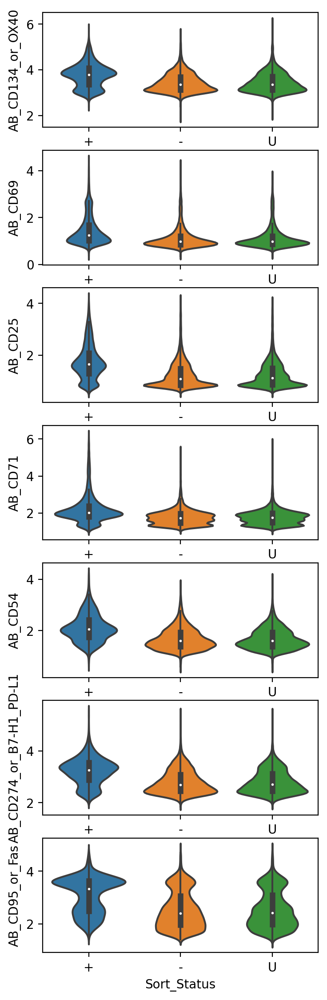

In [67]:
nrows = len(markers_magic.columns)
ncols = 1
fig, axes = plt.subplots(dpi = 200, figsize = (4, 2*len(markers_magic.columns)),
                                               nrows = nrows, ncols = ncols)

for i, p in enumerate(markers_magic.columns):
    print(p)
    ax = axes[i]
    sns.violinplot(x = adata_ADT.obs.loc[markers_magic.index, pheno_col], y = markers_magic[p], ax = ax)

In [125]:
aim_assoc_geps = ['Early-Activation',
'ISG',
'BCL2-Survival',
'Treg',
'OX40/EBI3-Activation',
'Cytoskeleton',
'Th17',
'ICOS/CD38-Activation',
'Exhaustion',
'RGCC/MYADM',
'CCR10-Migration',
'CellCycle-S',
'Tfh-2',
'CTLA4+/CD38+-Activation',
'HeatShock',
'Tph',
'Multi-Cytokine',
'TIMD4/TIM3-Activation',
'Th17-2',
'Th2-2',
'Metallothionein',
'CellCycle-Late-S',
'CellCycle-G2M',
                   ]

In [126]:
cc_assoc_geps = ['CTLA4+/CD38+-Activation', 'Cytoskeleton', 'Early-Activation',
       'Exhaustion', 'HLA', 'ICOS/CD38-Activation', 'IL10/IL19-Secretion',
       'Metallothionein', 'OX40/EBI3-Activation', 'TIMD4/TIM3-Activation',
       'Th17-2', 'Tph']

In [127]:
gep_info = read_dataset_log('cGEP_Name')
rename_map = dict(zip(gep_info['cGep_Name'], gep_info['Short_Name']))


In [128]:
usage = pd.read_csv(params.loc[dataset, 'tcat_fn'], index_col = 0, sep = '\t')

In [129]:
usage.columns = usage.columns.map(rename_map)
usage_norm = usage.div(usage.sum(axis=1), axis=0)


In [130]:
activation_geps = sorted(list(set(aim_assoc_geps).intersection(cc_assoc_geps)))
activation_geps

['CTLA4+/CD38+-Activation',
 'Cytoskeleton',
 'Early-Activation',
 'Exhaustion',
 'ICOS/CD38-Activation',
 'Metallothionein',
 'OX40/EBI3-Activation',
 'TIMD4/TIM3-Activation',
 'Th17-2',
 'Tph']

0 CTLA4+/CD38+-Activation
1 Cytoskeleton
2 Early-Activation
3 Exhaustion
4 ICOS/CD38-Activation
5 Metallothionein
6 OX40/EBI3-Activation
7 TIMD4/TIM3-Activation
8 Th17-2
9 Tph


Text(0.5, 0.9, 'Stimseq')

/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converge."
/PHShome/mc1070/anaconda3/envs/cnmf_env2v2/lib/python3.7/site-packages/datashader/mpl_ext.py:144: UserWarning: EqHistColorMapper warning: Histogram equalization did not converge.
  "EqHistColorMapper warning: Histogram equalization did not converg

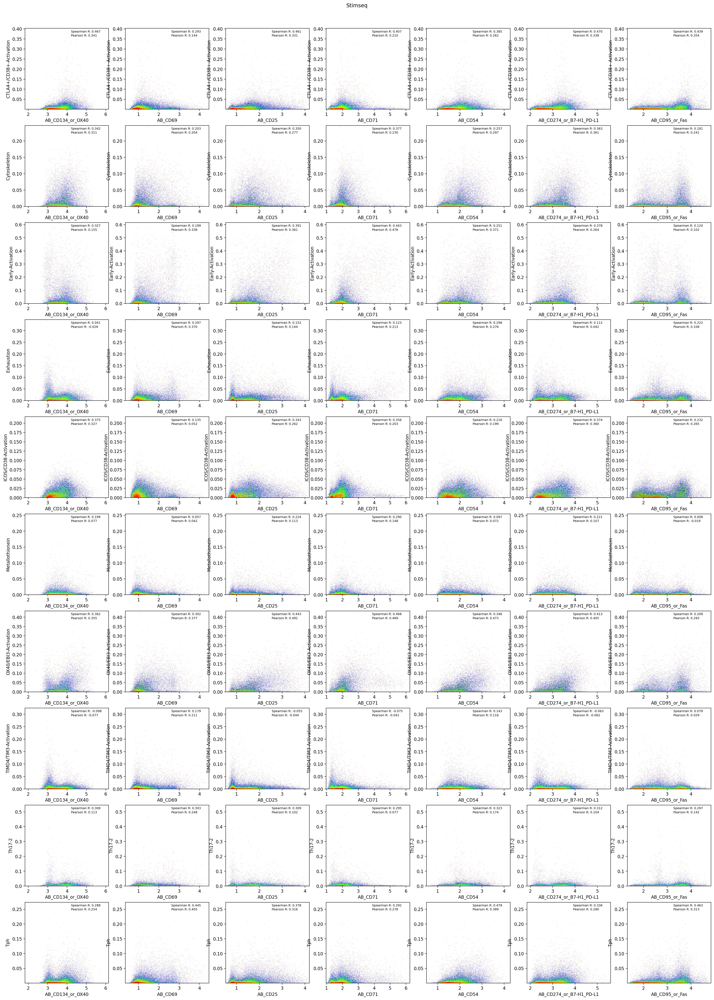

In [131]:
nrows = len(activation_geps)
ncols = len(markers_magic.columns)
fig, axes = plt.subplots(dpi = 200, figsize = (4*len(markers_magic.columns), 4*len(activation_geps)),
                                               nrows = nrows, ncols = ncols)

for i, gep in enumerate(activation_geps):
    print(i, gep)
    # i = i-1
    
    for j, p2 in enumerate(markers_magic.columns):
        # if j >= i:
        ax = axes[i, j]
        x = markers_magic[p2]
        y = usage_norm.loc[markers_magic.index, gep]

        r_p, _ = pearsonr(x, y)
        r_s, _ = spearmanr(x, y)

        # ax.scatter(x, y)
        dsshow(pd.DataFrame({'x':x, 'y':y}), 
               ds.Point('x', 'y'), norm='eq_hist', cmap=cmap, ax = ax, aspect = 'auto')
        # ax.scatter(x = x, y = y, s = 0.5, edgecolors='none',)
        ax.text(x = .55, y = .95, s = 'Spearman R: %.3f' % r_s, fontsize = 7, transform=ax.transAxes)
        ax.text(x = .55, y = .9, s = 'Pearson R: %.3f' % r_p, fontsize = 7, transform=ax.transAxes)
        ax.set_xlabel(p2)
        ax.set_ylabel(gep)
plt.suptitle('%s' % dataset, y = 0.9)